# Project C3: Lung Disease Prediction from X-ray Images Using Attention-Guided Convolutional Neural Network

### Abstarct

In this project, we implemented an Attention-Guided Convolutional Neural Network (AG-CNN) to perform disease diagnosis classification on chest X-ray images. The AG-CNN architecture consists of three branches: the Global Branch, the Local Branch, and the Fusion Branch. The Global Branch processes the original images and is trained independently to classify them. Feature maps from a specific layer of the Global Branch are then used to create an attention mask, which is applied to the original images to generate cropped images. These cropped images are fed into the Local Branch, which is trained independently from the Global Branch. After training both branches, a Fusion Model is constructed by concatenating the feature maps from both the Global and Local Branches, and the classification task is performed again. The results demonstrate that the Fusion Model improves the performance of the Global Branch in disease diagnosis.

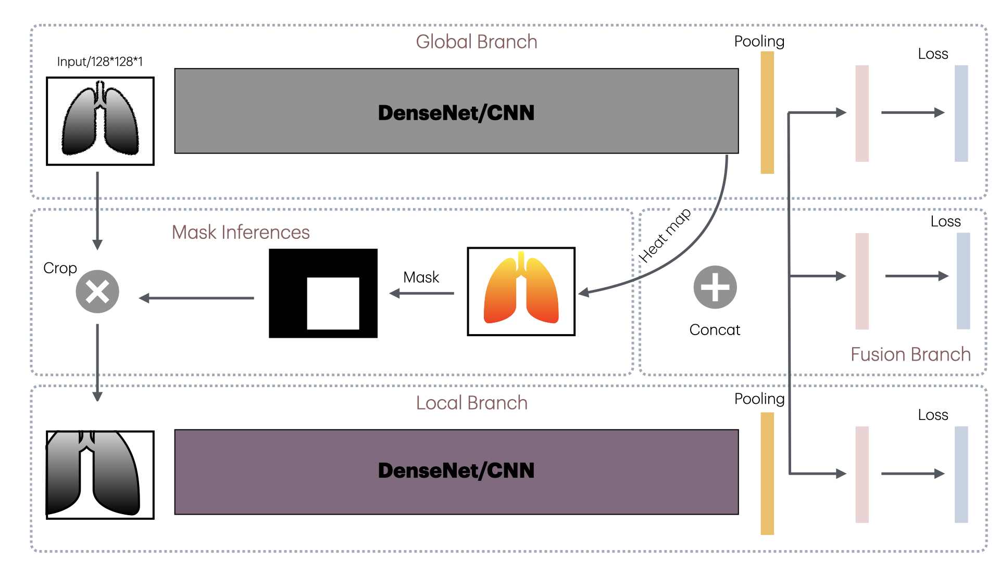

## Libraries

In [3]:
import os
import random
import time
import pickle
import zipfile
import logging
import requests

import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import ImageFont
from tqdm import tqdm
from skimage.measure import label
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize


import tensorflow as tf
from tensorflow.keras import layers, models, optimizers, losses, metrics
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.layers import AvgPool2D, GlobalAveragePooling2D, MaxPool2D, Input, Conv2D, BatchNormalization, Dense, ReLU, concatenate, Lambda
from tensorflow.keras.models import load_model, clone_model, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow.keras.backend as K

import visualkeras


C:\ProgramData\Anaconda3\lib\site-packages\scipy\__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## COVID19, Pneumonia and Normal Chest X-ray PA Dataset

#### Download the Dataset

In [ ]:
url = 'https://prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com/jctsfj2sfn-1.zip'
local_filename = 'dataset.zip'

# Make the request and get the response
response = requests.get(url)

# Save the content to a local file
with open(local_filename, 'wb') as f:
    f.write(response.content)

print(f"File downloaded and saved as {local_filename}")

#### Unzip the Dataset

In [2]:
# Specify the name of the zip file
zip_filename = 'covid19-pneumonia-normal-chest-xraypa-dataset.zip'

# Specify the target directory for extraction
target_directory = 'dataset'

# Create the target directory if it doesn't exist
if not os.path.exists(target_directory):
    os.makedirs(target_directory)

# Ensure the file exists in the current directory
if os.path.exists(zip_filename):
    # Open the zip file in read mode
    with zipfile.ZipFile(zip_filename, 'r') as zip_ref:
        # Extract all the contents into the target directory
        zip_ref.extractall(target_directory)
    print(f"Unzipped {zip_filename} successfully into {target_directory}.")
else:
    print(f"{zip_filename} does not exist.")

Unzipped covid19-pneumonia-normal-chest-xraypa-dataset.zip successfully into dataset.


In [21]:
dir = '/Users/sepideh/Desktop/C3_ HDA/dataset/'

def load_and_preprocess_data(dir):
    classes = ["covid", "normal", "pneumonia"]
    data = []
    labels = []

    for class_name in classes:
        class_path = os.path.join(dir, class_name)
        for image_name in tqdm(os.listdir(class_path), desc=f'Loading {class_name} images'):
            image_path = os.path.join(class_path, image_name)
            image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Read as grayscale
            image = cv2.resize(image, (128, 128))  # Adjust size as needed
            data.append(np.expand_dims(image, axis=-1))  # Add a channel dimension
            labels.append(classes.index(class_name))

    return np.array(data), np.array(labels)

# Load and show one sample
data, labels = load_and_preprocess_data(dir)

Loading pneumonia images: 100%|████████████| 1525/1525 [00:06<00:00, 244.05it/s]


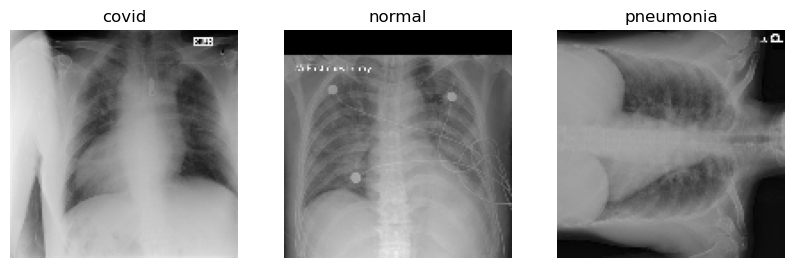

In [22]:
classes = ["covid", "normal", "pneumonia"]
fig, axes = plt.subplots(1, 3, figsize=(10, 4))
for i, (class_name, sample_image) in enumerate(zip(classes, data)):
    axes[i].imshow(sample_image.squeeze(), cmap='gray')
    axes[i].set_title(class_name)
    axes[i].axis('off')

plt.show()

#### Split the Data into Train, Validation and Test

In [23]:
# Function to save images to respective directories
def save_images_to_directory(images, labels, output_dir, subset):
    classes = ["covid", "normal", "pneumonia"]
    for i, (img, label) in enumerate(zip(images, labels)):
        class_name = classes[label]
        subset_dir = os.path.join(output_dir, subset, class_name)
        os.makedirs(subset_dir, exist_ok=True)
        img_path = os.path.join(subset_dir, f"{i}.png")
        cv2.imwrite(img_path, img.squeeze())


In [24]:
output_dir = './organized_data/'

# Split the data into train, validation, and test sets with stratification
train_data, temp_data, train_labels, temp_labels = train_test_split(data, labels, test_size=0.4, stratify=labels, random_state=42)
val_data, test_data, val_labels, test_labels = train_test_split(temp_data, temp_labels, test_size=0.5, stratify=temp_labels, random_state=42)

In [25]:
# Save the images to the respective directories
save_images_to_directory(train_data, train_labels, output_dir, 'train')
save_images_to_directory(val_data, val_labels, output_dir, 'validation')
save_images_to_directory(test_data, test_labels, output_dir, 'test')

print(f"Images have been organized and saved to {output_dir}")

Images have been organized and saved to ./organized_data/


#### Create Dataset Using  ImageDataGenerator

In [2]:
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_dir = os.path.join(output_dir, 'train')
val_dir = os.path.join(output_dir, 'validation')
test_dir = os.path.join(output_dir, 'test')

datagen_train = ImageDataGenerator(
    rotation_range=360,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1,
    featurewise_center=True,
    featurewise_std_normalization=True,
    rescale=1./255  # Normalize pixel values to be between 0 and 1
)

datagen_val = ImageDataGenerator(rescale=1./255)

# Create generators for training and validation data
train_generator = datagen_train.flow_from_directory(
    directory=train_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

val_generator = datagen_val.flow_from_directory(
    directory=val_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

test_generator = datagen_val.flow_from_directory(
    directory=test_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=False
)


Found 2745 images belonging to 3 classes.
Found 915 images belonging to 3 classes.
Found 915 images belonging to 3 classes.


#### Plot Some Samples from the Train Dataset

C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\legacy\preprocessing\image.py:1263: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(
C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\legacy\preprocessing\image.py:1273: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(


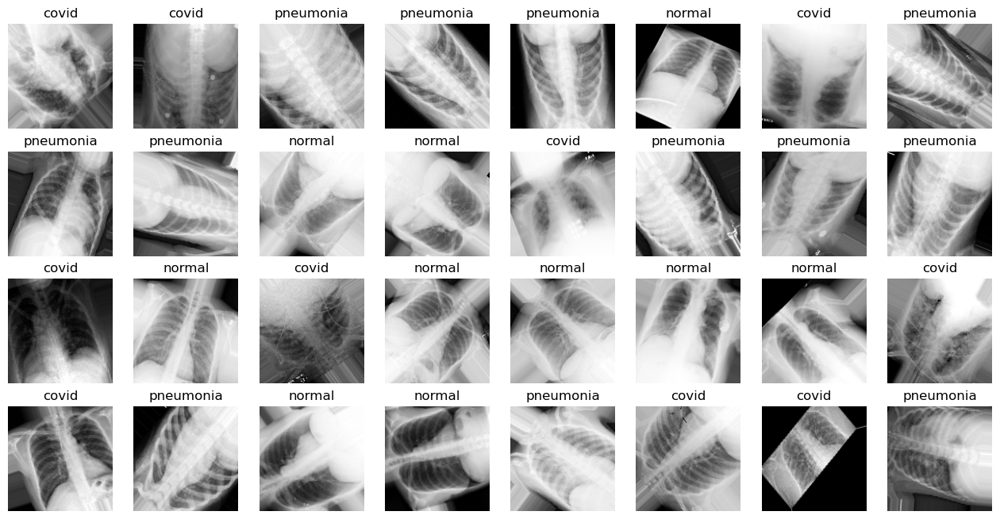

In [3]:
# Define classes
classes = ["covid", "normal", "pneumonia"]
plt.rcParams.update({'font.size': 10})

# Get a batch of images and labels from the train generator
batch_images, batch_labels = next(train_generator)

# Function to plot images
def plot_images(images, labels, class_names, n_cols=8):
    n_rows = len(images) // n_cols + (len(images) % n_cols != 0)
    plt.figure(figsize=(16, 2 * n_rows))
    for i in range(len(images)):
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(class_names[int(labels[i])])
        plt.axis('off')

    plt.show()

# Plot some images from the validation set
plot_images(batch_images, batch_labels, classes)


#### Plot Some Samples from the Validation Dataset

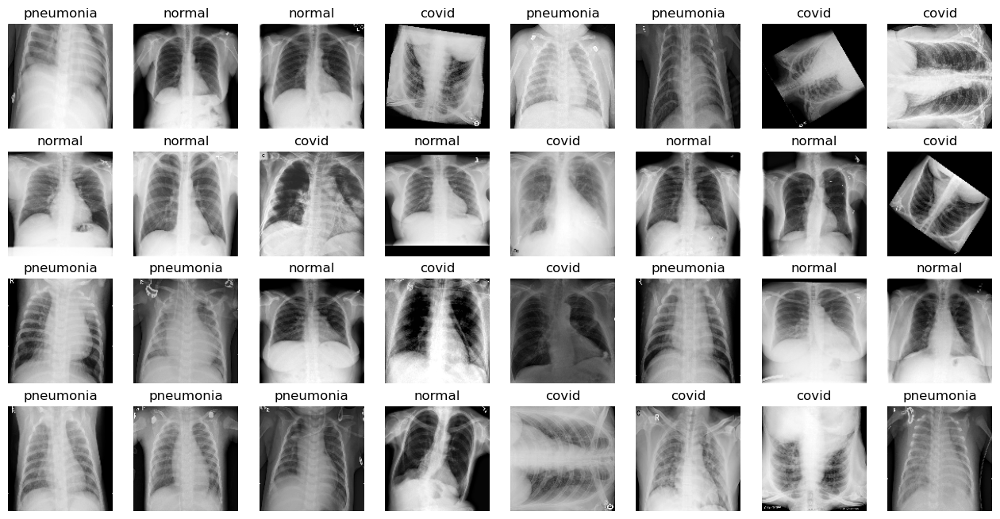

In [4]:
sample_images, sample_labels = next(val_generator)

plot_images(sample_images, sample_labels, classes)


#### The Distribution of Data

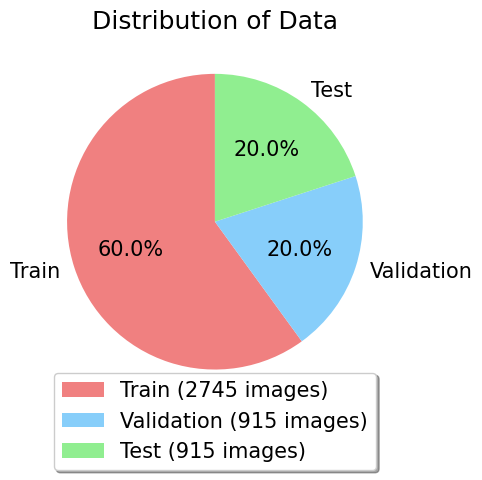

In [5]:
plt.rcParams.update({'font.size': 15})

num_train = 2745
num_val = 915
num_test = 915

labels = ['Train', 'Validation', 'Test']
sizes = [num_train, num_val, num_test]

fig, ax = plt.subplots()
pie = ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=['lightcoral', 'lightskyblue', 'lightgreen'])

# Add the number of data points below each percentage directly to the legend
legend_labels = [f"{label} ({size} images)" for label, size in zip(labels, sizes)]
ax.legend(pie[0], legend_labels, loc="lower center", bbox_to_anchor=(0.5, -0.2), fancybox=True, shadow=True)

plt.title('Distribution of Data')
plt.show()


## Attention-Guided CNN: Simpe Approach

### Global Branch with Simple CNN 

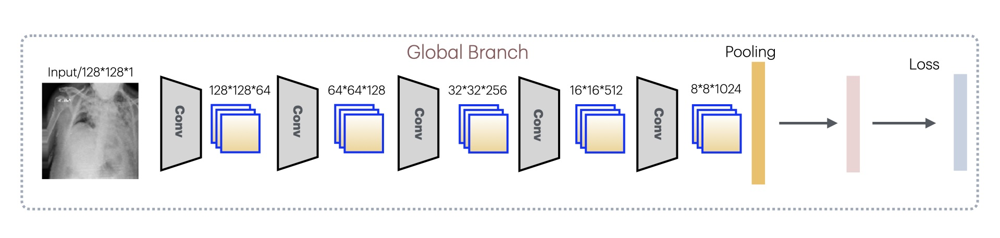

In [60]:
def create_custom_cnn(input_shape):
    inputs = layers.Input(shape=input_shape)

    # First convolutional block
    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2))(x)
    #x = layers.Dropout(0.25)(x)

    # Second convolutional block
    x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2))(x)
    #x = layers.Dropout(0.25)(x)

    # Third convolutional block
    x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2))(x)
    #x = layers.Dropout(0.25)(x)

    # Fourth convolutional block
    x = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2))(x)
    #x = layers.Dropout(0.25)(x)
    
    # Fifth convolutional block
    x = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2))(x)
    #x = layers.Dropout(0.25)(x)


    # Flatten layer to transition from convolutional to dense layers
    #x = layers.Flatten()(x)
    # Global average pooling
    x = layers.GlobalAveragePooling2D()(x)

    # Fully connected layers
    
    outputs = layers.Dense(3, activation='softmax')(x)

    model = models.Model(inputs, outputs)
    return model


In [61]:
input_shape = (128, 128, 1)
simple_cnn = create_custom_cnn(input_shape)
simple_cnn.compile(optimizer=optimizers.Adam(1e-3),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

# Model summary
simple_cnn.summary()

Model: "functional_9915"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)      │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 128, 128, 64)   │           640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 128, 128, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_12 (Conv2D)              │ (None, 8, 8, 1024)     │     4,719,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 8, 8, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 4, 4, 1024)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_3      │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,280,451 (23.96 MB)

 Trainable params: 6,276,483 (23.94 MB)

 Non-trainable params: 3,968 (15.50 KB)

#### Model Visualization

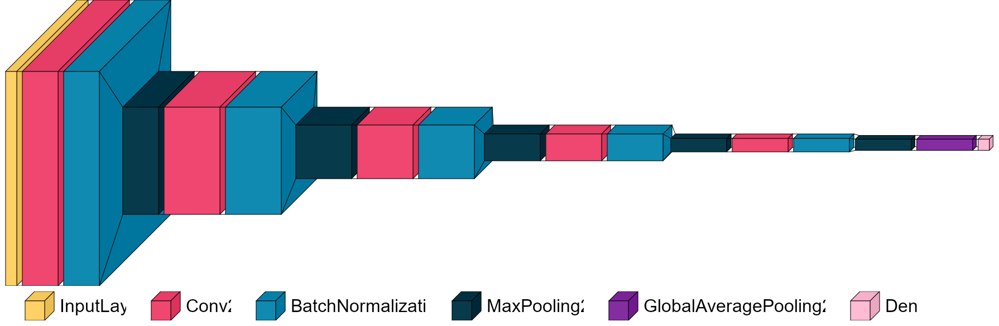

In [62]:
# Load font
try:
    font = ImageFont.truetype("arial.ttf", 32)  # using comic sans is strictly prohibited!
except IOError:
    font = None  # Fallback to default font if arial is not found

# Visualize the model
visualkeras.layered_view(simple_cnn, legend=True, font=font, scale_xy=3, scale_z=1, max_z=100)

####  Training The Global Branch

In [63]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=10,
    verbose=1,
    mode='auto'
)

# Adjust batch size and steps per epoch
batch_size = 32
steps_per_epoch = 2745 // batch_size
validation_steps = 915 // batch_size


start_time = time.time()

history_simple_cnn = simple_cnn.fit(train_generator,
                           validation_data=val_generator,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('simple_cnn_model_history.pkl', 'wb') as file:
    pickle.dump(history_simple_cnn.history, file)

simple_cnn.save('simple_cnn.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100


C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\legacy\preprocessing\image.py:1263: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(
C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\legacy\preprocessing\image.py:1273: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(


85/85 ━━━━━━━━━━━━━━━━━━━━ 183s 2s/step - accuracy: 0.5489 - loss: 1.9178 - val_accuracy: 0.3326 - val_loss: 3.0991 - learning_rate: 0.0010
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 3:06 2s/step - accuracy: 0.7188 - loss: 0.6551

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7188 - loss: 0.6551 - val_accuracy: 0.3684 - val_loss: 3.1546 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 192s 2s/step - accuracy: 0.7127 - loss: 0.7194 - val_accuracy: 0.3348 - val_loss: 1.6815 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.8750 - loss: 0.4745 - val_accuracy: 0.2632 - val_loss: 1.8258 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 192s 2s/step - accuracy: 0.7845 - loss: 0.5781 - val_accuracy: 0.3348 - val_loss: 1.7824 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.6875 - loss: 0.7514 - val_accuracy: 0.2105 - val_loss: 2.0045 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 196s 2s/step - accuracy: 0.8128 - loss: 0.5151 - val_accuracy: 0.3114 - val_loss: 2.4706 - learning_rate: 0.0010
Epoch 8/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.7812 - loss: 0.5095 - val_accuracy: 0.

#### Validation Accuracy v.s. Training Accuracy

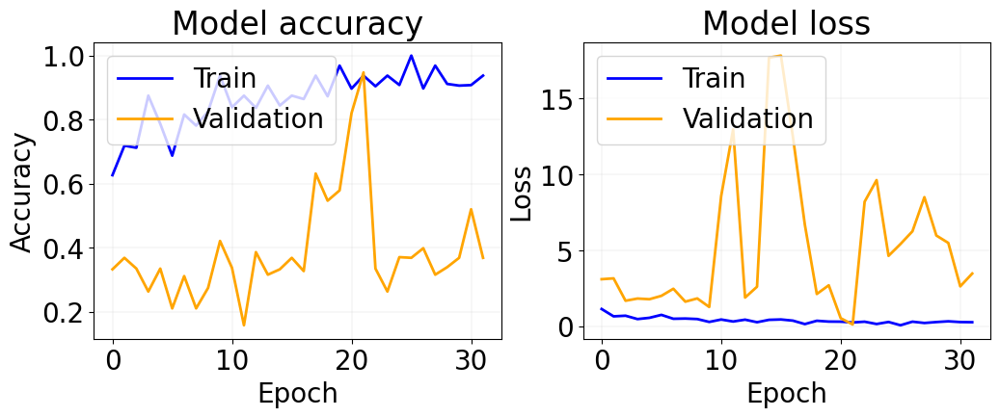

In [64]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_simple_cnn.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_simple_cnn.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_simple_cnn.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_simple_cnn.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()


#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 390ms/step - accuracy: 0.8517 - loss: 0.4678
Test Loss: 0.492048054933548
Test Accuracy: 0.8338797688484192
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 380ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.84      0.84      0.84       305
           1       0.77      0.86      0.81       305
           2       0.91      0.80      0.85       305

    accuracy                           0.83       915
   macro avg       0.84      0.83      0.83       915
weighted avg       0.84      0.83      0.83       915



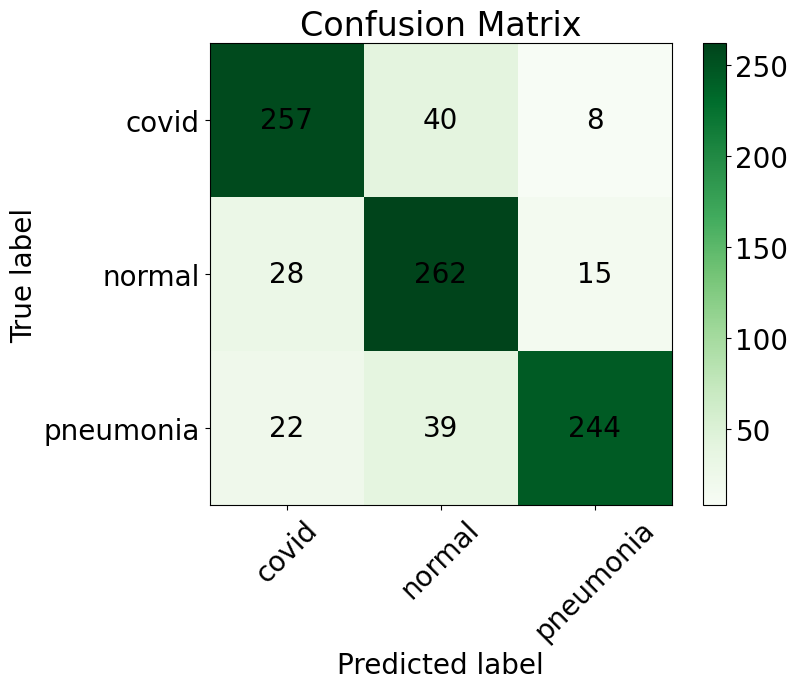

In [65]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = simple_cnn.evaluate(test_generator)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(simple_cnn.predict(test_generator), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator.class_indices))
plt.xticks(tick_marks, test_generator.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator.class_indices.keys())

for i in range(len(test_generator.class_indices)):
    for j in range(len(test_generator.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 349ms/step


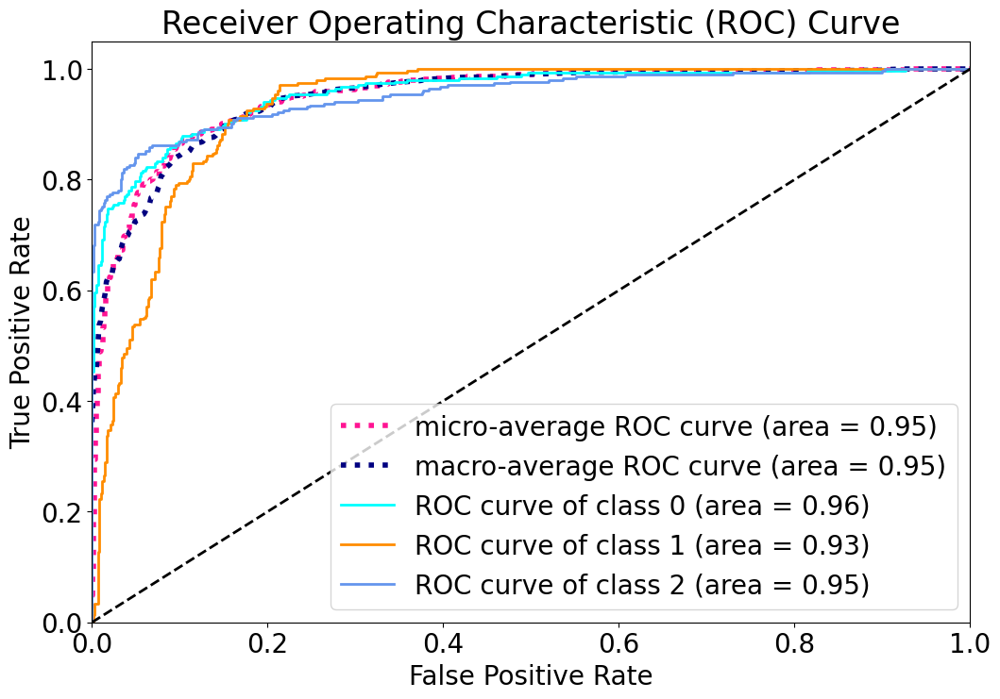

In [66]:
# Binarize the output
n_classes = len(test_generator.class_indices)
y_test = label_binarize(test_generator.classes, classes=[0, 1, 2])
y_score = simple_cnn.predict(test_generator)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


In [69]:
global_model = load_model('simple_cnn.keras')

### Mask Inference 

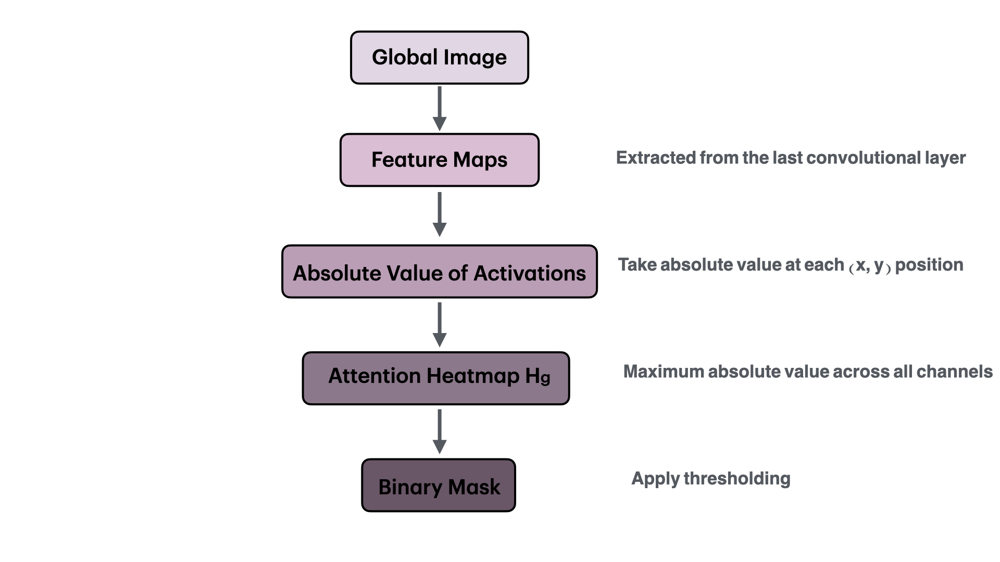

In [75]:
def get_heatmap(images, model, last_conv_layer_name, pred_index=None):

    last_conv_layer = model.get_layer(last_conv_layer_name)
    last_conv_layer_model = tf.keras.Model(inputs=global_model.input, outputs=last_conv_layer.output)
    conv_output = last_conv_layer_model(images, training=False)
    
    heatmap = tf.reduce_max(tf.abs(conv_output), axis=-1)
    
    heatmap = tf.maximum(heatmap, 0)
    heatmap /= (np.max(heatmap) + 1e-7)  # Add epsilon to avoid division by zero

    return heatmap

def attention_guided_mask_inference_batch(generator, model, last_conv_layer_name='conv2d_12'):
    """
    Generate attention masks using Grad-CAM for a batch of images from the generator.

    :param generator: Data generator providing images and labels.
    :param model: The trained model.
    :param last_conv_layer_name: The name of the last convolutional layer.
    :return: Tuple of masks and images.
    """
    masks = []

    images, _ = next(generator)
    for img in images:
        img = tf.expand_dims(img, axis=0)  # Add batch dimension
#         heatmap = get_grad_cam_heatmap(img, model, last_conv_layer_name)
        heatmap = get_heatmap(img, model, last_conv_layer_name)
        if heatmap is None:
            continue

        # Generate binary masks
        threshold = 0.7  # you may need to adjust this value
        mask = heatmap > threshold
        masks.append(tf.cast(mask, tf.float32))  # Change here: use tf.cast instead of astype

    masks = tf.convert_to_tensor(masks, dtype=tf.float32)
    masks = tf.expand_dims(masks, axis=-1)  # Add channel dimension

    return masks, images  # Return masks and original images

def crop_local_region_batch(images, masks, input_shape=(128, 128)):
    cropped_images = []
    for i in range(images.shape[0]):
        if i >= len(masks):  # Check if the index is within bounds of masks
            continue

        # Resize the mask to match the input image dimensions
        mask = masks[i].numpy().astype(np.uint8)  # Ensure mask is a numpy array
        if mask.size == 0:
            continue

        # Remove extra dimensions from the mask
        mask = np.squeeze(mask)

        # Check the shape of the mask before resizing
        #print(f"Mask shape before resizing: {mask.shape}")

        mask = cv2.resize(mask, (input_shape[1], input_shape[0]))  # Resize to (width, height)

        # Check the shape of the mask after resizing
        #print(f"Mask shape after resizing: {mask.shape}")

        image = images[i]
        if isinstance(image, tf.Tensor):
            image = image.numpy()  # Convert tensor to numpy array if needed

        # Check the shape of the image
        #print(f"Image shape: {image.shape}")

        # Find contours in the resized mask
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if len(contours) == 0:
            cropped_image = cv2.resize(image, (input_shape[1], input_shape[0]))  # Resize the entire image if no contours found
            cropped_images.append(cropped_image)
            continue

        # Find the largest contour by area
        largest_contour = max(contours, key=cv2.contourArea)

        # Crop the image using the bounding box of the largest contour
        x, y, w, h = cv2.boundingRect(largest_contour)
        cropped_image = image[y:y+h, x:x+w]
        cropped_image = cv2.resize(cropped_image, (input_shape[1], input_shape[0]))  # Resize to (width, height)
        cropped_images.append(cropped_image)

    cropped_images = np.array(cropped_images)
    cropped_images = np.expand_dims(cropped_images, axis=-1)  # Add channel dimension
    return tf.convert_to_tensor(cropped_images, dtype=tf.float32)


def save_cropped_images_to_directory(generator, model, output_dir, subset, last_conv_layer_name='conv2d_12'):
    original_images_dir = os.path.join(output_dir, f'{subset}_original')
    cropped_images_dir = os.path.join(output_dir, f'{subset}_cropped')

    classes = ["covid", "normal", "pneumonia"]
    os.makedirs(original_images_dir, exist_ok=True)
    os.makedirs(cropped_images_dir, exist_ok=True)

    # Reset the generator
    generator.reset()

    total_samples = 0

    while total_samples < generator.samples:
        # Get the next batch of images and labels
        images, labels = next(generator)
        # Generate masks and original images from the generator batch
        masks, _ = attention_guided_mask_inference_batch(generator, model, last_conv_layer_name)
        # Generate cropped images using the masks
        cropped_images = crop_local_region_batch(images, masks)

        for i, (original_img, cropped_img, label) in enumerate(zip(images, cropped_images, labels)):
            class_name = classes[int(label)]
            orig_class_dir = os.path.join(original_images_dir, class_name)
            crop_class_dir = os.path.join(cropped_images_dir, class_name)
            os.makedirs(orig_class_dir, exist_ok=True)
            os.makedirs(crop_class_dir, exist_ok=True)

            orig_img_path = os.path.join(orig_class_dir, f"{total_samples + i}.png")
            crop_img_path = os.path.join(crop_class_dir, f"{total_samples + i}.png")

            # Rescale images back to 0-255 before saving
            original_img = (original_img * 255).astype(np.uint8)
            cropped_img = (cropped_img.numpy() * 255).astype(np.uint8)

            cv2.imwrite(orig_img_path, original_img.squeeze())
            cv2.imwrite(crop_img_path, cropped_img.squeeze())

        total_samples += len(images)


def plot_samples_with_masks_and_crops(generator, model, num_samples=5, last_conv_layer_name='conv2d_12'):
    """
    Plot original images with masks overlayed and their corresponding cropped images using a generator.

    :param generator: The data generator.
    :param model: The trained model.
    :param num_samples: Number of samples to plot.
    :param last_conv_layer_name: The name of the last convolutional layer.
    """
    classes = ["covid", "normal", "pneumonia"]

    # Get a batch of images and labels from the generator
    batch_images, batch_labels = next(generator)
    num_samples = min(num_samples, len(batch_images))

    # Generate masks and original images from the generator batch
    masks, _ = attention_guided_mask_inference_batch(generator, model, last_conv_layer_name)
    cropped_images = crop_local_region_batch(batch_images, masks)

    # Make predictions on the batch images
    predictions = model.predict(batch_images)
    predicted_labels = np.argmax(predictions, axis=1)

    plt.figure(figsize=(20, num_samples * 5))

    for i in range(num_samples):
        original_img = batch_images[i].squeeze()
        mask = masks[i].numpy().squeeze()
        cropped_img = cropped_images[i].numpy().squeeze()
        true_label = classes[int(batch_labels[i])]
        predicted_label = classes[int(predicted_labels[i])]

        # Resize the CAM to the original image size
        heatmap = cv2.resize(mask, (original_img.shape[1], original_img.shape[0]))
        heatmap = np.uint8(255 * heatmap)
        # Apply a colormap to the heatmap
        heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

        # Overlay the heatmap on the original image
        alpha = 0.3
        superimposed_img = cv2.addWeighted(cv2.cvtColor((original_img * 255).astype('uint8'), cv2.COLOR_GRAY2BGR), 1 - alpha, heatmap_colored, alpha, 0)

        plt.subplot(num_samples, 4, i * 4 + 1)
        plt.imshow(original_img, cmap='gray')
        plt.title(f"Original: {true_label}")
        plt.axis('off')

        plt.subplot(num_samples, 4, i * 4 + 2)
        plt.imshow(heatmap_colored)
        plt.title(f"Mask: {true_label}")
        plt.axis('off')

        plt.subplot(num_samples, 4, i * 4 + 3)
        plt.imshow(superimposed_img)
        plt.title('Mask Overlayed')
        plt.axis('off')

        plt.subplot(num_samples, 4, i * 4 + 4)
        plt.imshow(cropped_img, cmap='gray')
        plt.title(f"True Label: {true_label}\nPredicted Label: {predicted_label}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


#### Some Samples from  The Generated Masks and Cropped Images

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


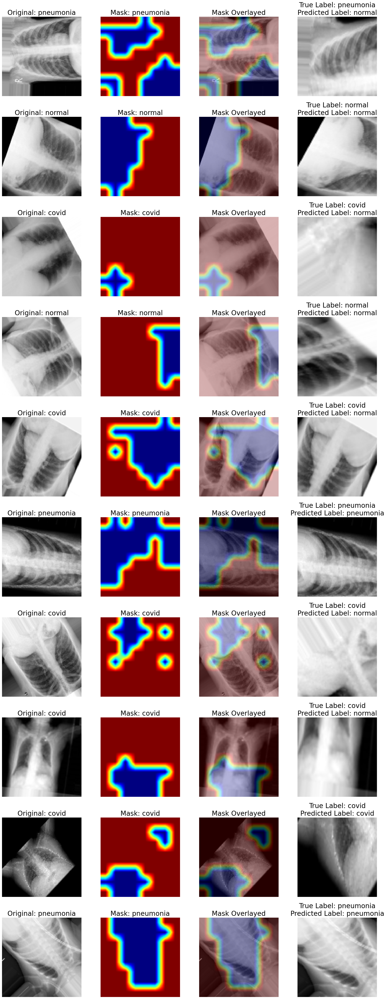

In [76]:
# Example of plotting using the train_generator and global_model
plot_samples_with_masks_and_crops(train_generator, global_model, num_samples=10, last_conv_layer_name='conv2d_12')

#### Saving The Cropped Images

In [77]:
# Now you can use this function with the data generators
save_cropped_images_to_directory(train_generator, global_model, output_dir, 'train')
save_cropped_images_to_directory(val_generator, global_model, output_dir, 'validation')
save_cropped_images_to_directory(test_generator, global_model, output_dir, 'test')

print(f"Original and cropped images have been organized and saved to {output_dir}")

Original and cropped images have been organized and saved to ./organized_data/


### Create The Local Dataset

In [78]:
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_dir = os.path.join(output_dir, 'train_cropped')
val_dir = os.path.join(output_dir, 'validation_cropped')
test_dir = os.path.join(output_dir, 'test_cropped')

datagen_train_local = ImageDataGenerator(rescale=1./255)

datagen_val_local = ImageDataGenerator(rescale=1./255)

# Create generators for training and validation data
train_generator_local = datagen_train_local.flow_from_directory(
    directory=train_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

val_generator_local = datagen_val_local.flow_from_directory(
    directory=val_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

test_generator_local = datagen_val_local.flow_from_directory(
    directory=test_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=False
)


Found 2738 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.


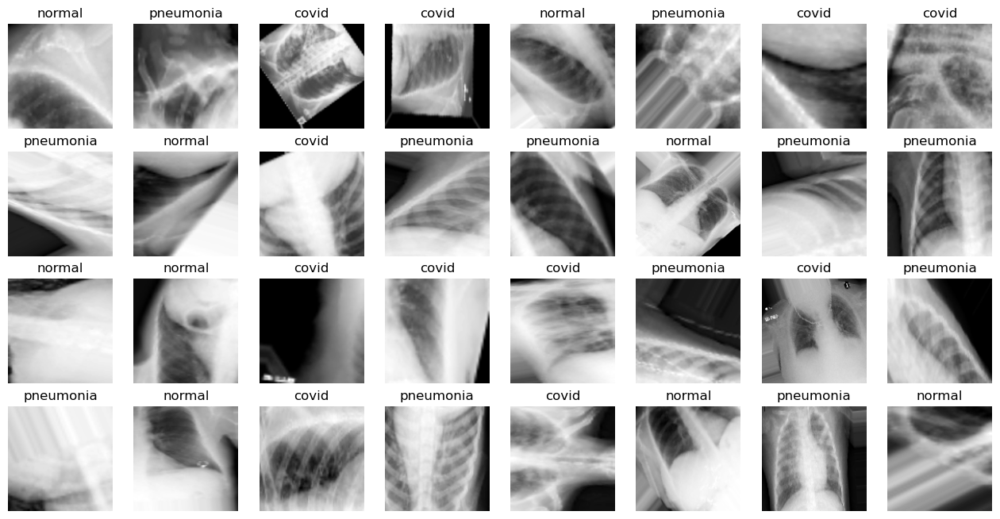

In [79]:
classes = ["covid", "normal", "pneumonia"]
plt.rcParams.update({'font.size': 10})

# Get a batch of images and labels from the validation generator
batch_images, batch_labels = next(train_generator_local)

# Function to plot images
def plot_images(images, labels, class_names, n_cols=8):
    n_rows = len(images) // n_cols + (len(images) % n_cols != 0)
    plt.figure(figsize=(16, 2 * n_rows))
    for i in range(len(images)):
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(images[i],cmap='gray')
        plt.title(class_names[int(labels[i])])
        plt.axis('off')

    plt.show()

# Plot some images from the validation set
plot_images(batch_images, batch_labels, classes)


### Local Branch

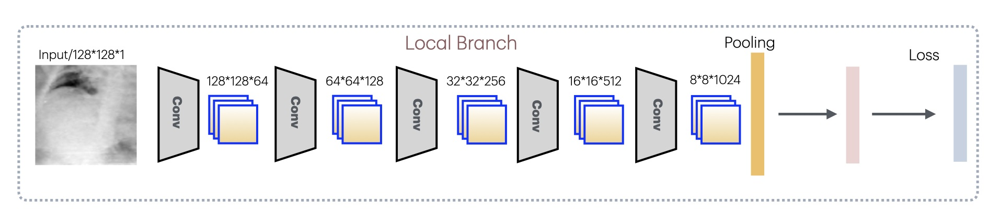

In [86]:
input_shape = (128, 128, 1)
local_model = create_custom_cnn(input_shape)
local_model.compile(optimizer=optimizers.Adam(),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

# Model summary
local_model.summary()

Model: "functional_19183"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)      │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 128, 128, 64)   │           640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 128, 128, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_20 (Conv2D)              │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 16, 16, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 8, 8, 1024)     │     4,719,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 8, 8, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 4, 4, 1024)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_5      │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,280,451 (23.96 MB)

 Trainable params: 6,276,483 (23.94 MB)

 Non-trainable params: 3,968 (15.50 KB)

#### Training The Local Branch

In [87]:
# Define callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=20,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=10,
    verbose=1,
    mode='auto'
)

steps_per_epoch = 2738 // 32
validation_steps = 902 // 32

start_time = time.time()

history_local_model = local_model.fit(train_generator_local,
                           validation_data=val_generator_local,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('local_model_history.pkl', 'wb') as file:
    pickle.dump(history_local_model.history, file)

local_model.save('local_model.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 176s 2s/step - accuracy: 0.4456 - loss: 2.3269 - val_accuracy: 0.3192 - val_loss: 2.3310 - learning_rate: 0.0010
Epoch 2/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.5625 - loss: 1.0237 - val_accuracy: 0.3333 - val_loss: 2.2737 - learning_rate: 0.0010
Epoch 3/100


C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 172s 2s/step - accuracy: 0.5823 - loss: 0.9193 - val_accuracy: 0.3382 - val_loss: 2.0367 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.5938 - loss: 1.0053 - val_accuracy: 0.1667 - val_loss: 2.8008 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 175s 2s/step - accuracy: 0.5932 - loss: 0.9051 - val_accuracy: 0.3527 - val_loss: 2.2472 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.7188 - loss: 1.0120 - val_accuracy: 0.3333 - val_loss: 2.1480 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 179s 2s/step - accuracy: 0.6328 - loss: 0.8298 - val_accuracy: 0.3371 - val_loss: 1.8327 - learning_rate: 0.0010
Epoch 8/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8125 - loss: 0.5213 - val_accuracy: 0.1667 - val_loss: 2.4203 - learning_rate: 0.0010
Epoch 9/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 184s 2s/step - accuracy: 0.6567 - loss: 0.7801 - val_accuracy: 0

#### Validation v.s. Training Accuracy

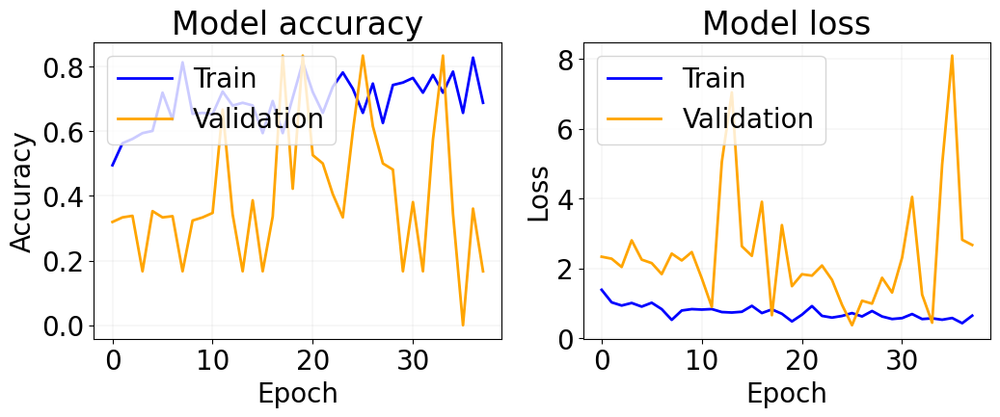

In [88]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_local_model.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_local_model.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_local_model.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_local_model.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()


#### Test Accuracy

29/29 ━━━━━━━━━━━━━━━━━━━━ 28s 987ms/step - accuracy: 0.6313 - loss: 1.7777
Test Loss: 1.6217329502105713
Test Accuracy: 0.5942350625991821
29/29 ━━━━━━━━━━━━━━━━━━━━ 28s 996ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.55      0.59      0.57       305
           1       0.57      0.87      0.69       305
           2       0.85      0.31      0.45       292

    accuracy                           0.59       902
   macro avg       0.66      0.59      0.57       902
weighted avg       0.65      0.59      0.57       902



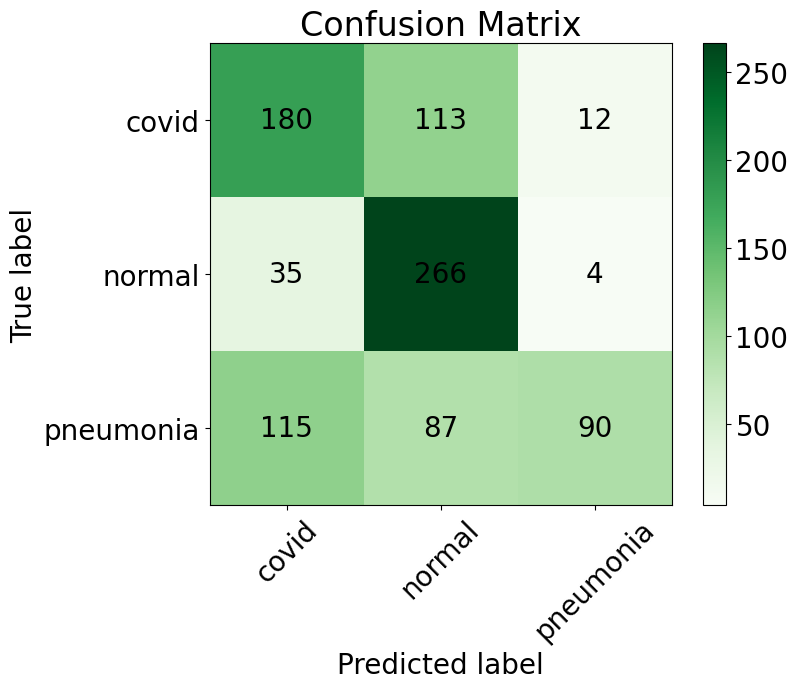

In [89]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = simple_cnn.evaluate(test_generator_local)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(simple_cnn.predict(test_generator_local), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_local.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_local.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_local.class_indices))
plt.xticks(tick_marks, test_generator_local.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_local.class_indices.keys())

for i in range(len(test_generator_local.class_indices)):
    for j in range(len(test_generator_local.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step


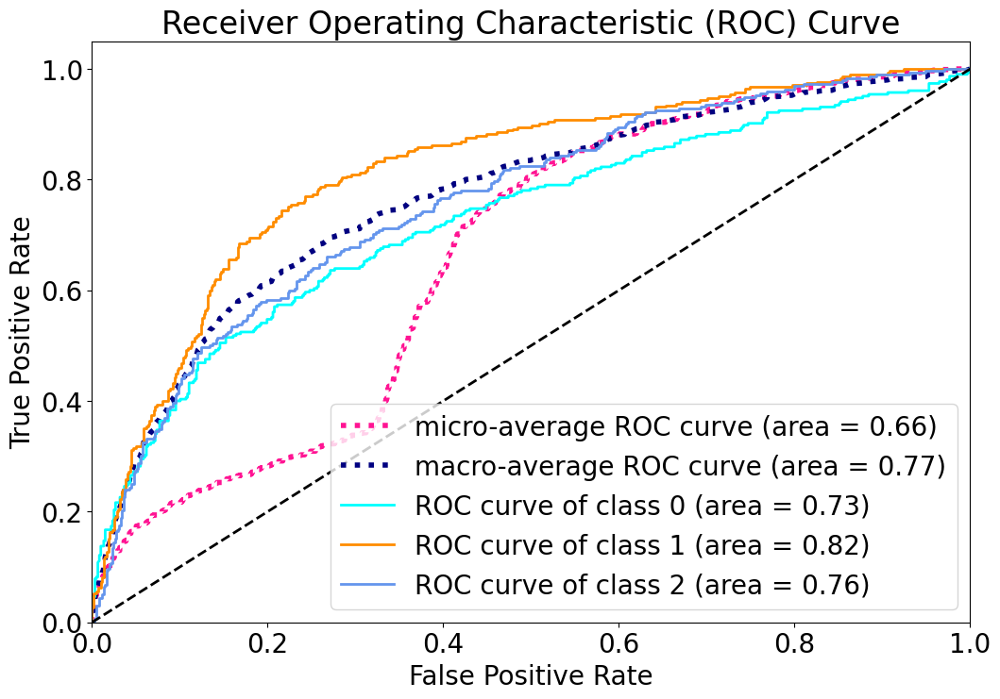

In [90]:
# Binarize the output
n_classes = len(test_generator_local.class_indices)
y_test = label_binarize(test_generator_local.classes, classes=[0, 1, 2])
y_score = local_model.predict(test_generator_local)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


### Create Fusion Dataset

In [91]:
class DualImageDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, global_dir, local_dir, batch_size, target_size=(128, 128), color_mode='grayscale', class_mode='sparse'):
        self.global_dir = global_dir
        self.local_dir = local_dir
        self.batch_size = batch_size
        self.target_size = target_size
        self.color_mode = color_mode
        self.class_mode = class_mode
        self.global_datagen = ImageDataGenerator(rescale=1./255)
        self.local_datagen = ImageDataGenerator(rescale=1./255)

        self.global_generator = self.global_datagen.flow_from_directory(
            directory=self.global_dir,
            target_size=self.target_size,
            batch_size=self.batch_size,
            color_mode=self.color_mode,
            class_mode=self.class_mode,
            shuffle=False
        )

        self.local_generator = self.local_datagen.flow_from_directory(
            directory=self.local_dir,
            target_size=self.target_size,
            batch_size=self.batch_size,
            color_mode=self.color_mode,
            class_mode=self.class_mode,
            shuffle=False
        )
        
        self.classes = self.global_generator.classes

    def __len__(self):
        return len(self.global_generator)

    def __getitem__(self, index):
        global_images, labels = self.global_generator[index]
        local_images, _ = self.local_generator[index]
        return (global_images, local_images), labels

    def on_epoch_end(self):
        pass  # No need to shuffle, so we can remove the shuffling logic

    @property
    def class_indices(self):
        return self.global_generator.class_indices

In [92]:
# output_dir = '/content/drive/MyDrive/HDA/organized_data/'
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_global_dir = os.path.join(output_dir, 'train_original')
train_local_dir = os.path.join(output_dir, 'train_cropped')
val_global_dir = os.path.join(output_dir, 'validation_original')
val_local_dir = os.path.join(output_dir, 'validation_cropped')
test_global_dir = os.path.join(output_dir, 'test_original')
test_local_dir = os.path.join(output_dir, 'test_cropped')

In [93]:
# Create custom data generators for training and validation data
train_generator_fusion = DualImageDataGenerator(train_global_dir, train_local_dir, batch_size=32)
val_generator_fusion = DualImageDataGenerator(val_global_dir, val_local_dir, batch_size=32)
test_generator_fusion = DualImageDataGenerator(test_global_dir, test_local_dir, batch_size=32)

Found 2738 images belonging to 3 classes.
Found 2738 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.


#### Plot Some Samples

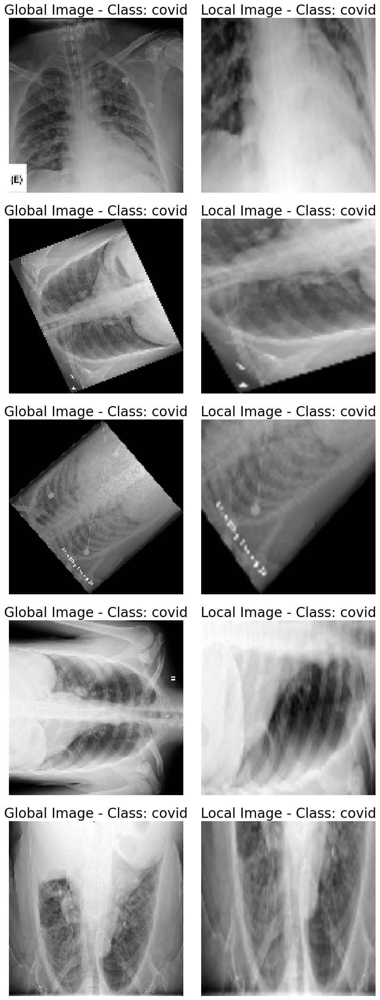

In [94]:
def plot_samples_from_dual_generator(generator, num_samples=5):
    """
    Plot samples from the DualImageDataGenerator to ensure global and local images belong to each other.

    :param generator: Instance of DualImageDataGenerator.
    :param num_samples: Number of samples to plot.
    """
    classes = list(generator.global_generator.class_indices.keys())
    total_samples_plotted = 0
    batch_index = 0
    
    plt.figure(figsize=(10, num_samples * 5))
    
    while total_samples_plotted < num_samples:
        (global_images, local_images), labels = generator[batch_index]
        batch_index += 1

        for j in range(len(global_images)):
            if total_samples_plotted >= num_samples:
                break
                
            global_img = global_images[j].squeeze()
            local_img = local_images[j].squeeze()
            label = classes[int(labels[j])]

            plt.subplot(num_samples, 2, total_samples_plotted * 2 + 1)
            plt.imshow(global_img, cmap='gray')
            plt.title(f"Global Image - Class: {label}")
            plt.axis('off')

            plt.subplot(num_samples, 2, total_samples_plotted * 2 + 2)
            plt.imshow(local_img, cmap='gray')
            plt.title(f"Local Image - Class: {label}")
            plt.axis('off')

            total_samples_plotted += 1
    
    plt.tight_layout()
    plt.show()

# Example usage of the plot function
plot_samples_from_dual_generator(test_generator_fusion, num_samples=5)


### Fusion Branch

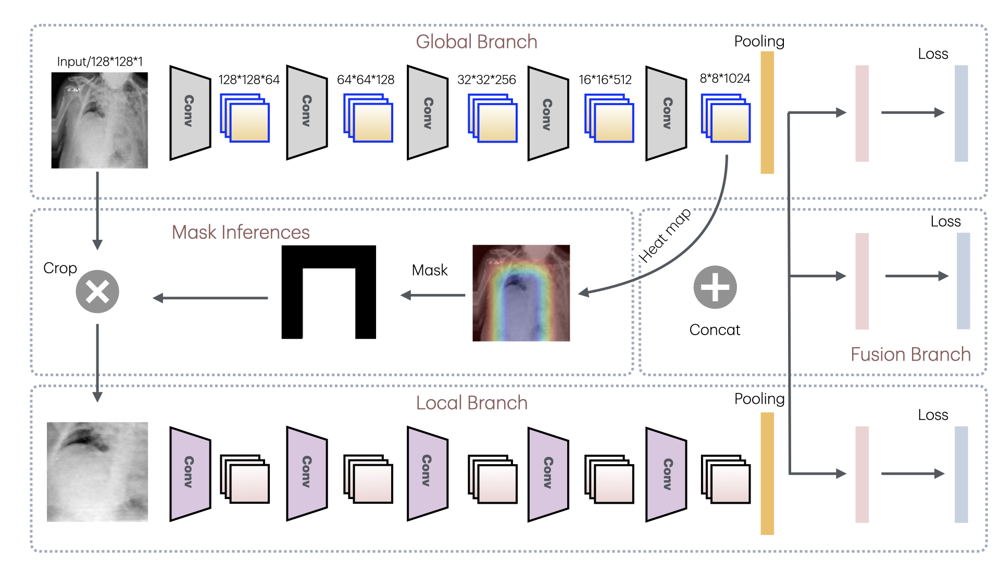

In [95]:
# Load the pre-trained global and local models
global_branch = load_model('simple_cnn.keras')
local_branch = load_model('local_model.keras')

In [96]:
# Function to rename the layers of a model
def rename_model_layers(model, prefix):
    config = model.get_config()
    for layer in config['layers']:
        layer['config']['name'] = prefix + layer['config']['name']
    new_model = Model.from_config(config)
    new_model.set_weights(model.get_weights())
    return new_model
# Rename the layers of the global and local models
global_branch = rename_model_layers(global_branch, 'global_')
local_branch = rename_model_layers(local_branch, 'local_')


In [97]:
global_branch.summary()

Model: "functional_9915"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ global_input_layer_7            │ (None, 128, 128, 1)    │             0 │
│ (InputLayer)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_conv2d_8 (Conv2D)        │ (None, 128, 128, 64)   │           640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_batch_normalization_5    │ (None, 128, 128, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d_5          │ (None, 64, 64, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_conv2d_9 (Conv2D)        │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_batch_normalization_6    │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d_6          │ (None, 32, 32, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_conv2d_10 (Conv2D)       │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_batch_normalization_7    │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d_7          │ (None, 16, 16, 256)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_conv2d_11 (Conv2D)       │ (None, 16, 16, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_batch_normalization_8    │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d_8          │ (None, 8, 8, 512)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_conv2d_12 (Conv2D)       │ (None, 8, 8, 1024)     │     4,719,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_batch_normalization_9    │ (None, 8, 8, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d_9          │ (None, 4, 4, 1024)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_global_average_pooling2… │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_dense_5 (Dense)          │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,280,451 (23.96 MB)

 Trainable params: 6,276,483 (23.94 MB)

 Non-trainable params: 3,968 (15.50 KB)

In [98]:
local_branch.summary()

Model: "functional_19183"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ local_input_layer_9             │ (None, 128, 128, 1)    │             0 │
│ (InputLayer)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_conv2d_18 (Conv2D)        │ (None, 128, 128, 64)   │           640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_batch_normalization_15    │ (None, 128, 128, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_max_pooling2d_15          │ (None, 64, 64, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_conv2d_19 (Conv2D)        │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_batch_normalization_16    │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_max_pooling2d_16          │ (None, 32, 32, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_conv2d_20 (Conv2D)        │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_batch_normalization_17    │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_max_pooling2d_17          │ (None, 16, 16, 256)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_conv2d_21 (Conv2D)        │ (None, 16, 16, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_batch_normalization_18    │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_max_pooling2d_18          │ (None, 8, 8, 512)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_conv2d_22 (Conv2D)        │ (None, 8, 8, 1024)     │     4,719,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_batch_normalization_19    │ (None, 8, 8, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_max_pooling2d_19          │ (None, 4, 4, 1024)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_global_average_pooling2d… │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_dense_7 (Dense)           │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,280,451 (23.96 MB)

 Trainable params: 6,276,483 (23.94 MB)

 Non-trainable params: 3,968 (15.50 KB)

In [99]:
# Freeze the layers in the global and local models
for layer in global_branch.layers:
    layer.trainable = False

for layer in local_branch.layers:
    layer.trainable = False

In [102]:
# Create the fusion model
def create_fusion_model(global_model, local_model):

    # Take the outputs of the last pooling layers
    global_output = global_model.get_layer('global_global_average_pooling2d_3').output
    local_output = local_model.get_layer('local_global_average_pooling2d_5').output

    # Concatenate the outputs of the global and local branches
    combined_input = layers.concatenate([global_output, local_output])

    # Add a fully connected layer and the final output layer
    #x = layers.Dense(512, activation='relu')(combined_input)
    #x = layers.Dense(64, activation='relu')
    x = layers.Dense(3, activation='softmax')(combined_input)

    model = models.Model(inputs=[global_model.input, local_model.input], outputs=x)
    return model


fusion_model = create_fusion_model(global_branch, local_branch)
fusion_model.compile(optimizer=optimizers.Adam(1e-3),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

fusion_model.summary()

Model: "functional_19187"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ global_input_layer… │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_input_layer_9 │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_8     │ (None, 128, 128,  │        640 │ global_input_lay… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_18     │ (None, 128, 128,  │        640 │ local_input_laye… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 128, 128,  │        256 │ global_conv2d_8[… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 128, 128,  │        256 │ local_conv2d_18[… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_max_pooling… │ (None, 64, 64,    │          0 │ global_batch_nor… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_max_pooling2… │ (None, 64, 64,    │          0 │ local_batch_norm… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_9     │ (None, 64, 64,    │     73,856 │ global_max_pooli… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_19     │ (None, 64, 64,    │     73,856 │ local_max_poolin… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 64, 64,    │        512 │ global_conv2d_9[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 64, 64,    │        512 │ local_conv2d_19[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_max_pooling… │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_max_pooling2… │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_10    │ (None, 32, 32,    │    295,168 │ global_max_pooli… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_20     │ (None, 32, 32,    │    295,168 │ local_max_poolin… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │      1,024 │ global_conv2d_10

 Total params: 12,560,899 (47.92 MB)

 Trainable params: 6,147 (24.01 KB)

 Non-trainable params: 12,554,752 (47.89 MB)

#### Training The Fusion Branch

In [103]:
# Define callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=20,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=10,
    verbose=1,
    mode='auto'
)

steps_per_epoch = 2738 // 32
validation_steps = 902 // 32

start_time = time.time()

history_fusion_model = fusion_model.fit(train_generator_fusion,
                           validation_data=val_generator_fusion,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('fusion_model_history.pkl', 'wb') as file:
    pickle.dump(history_fusion_model.history, file)

fusion_model.save('fusion_model.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100


C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


85/85 ━━━━━━━━━━━━━━━━━━━━ 88s 995ms/step - accuracy: 0.4717 - loss: 1.8619 - val_accuracy: 0.7545 - val_loss: 0.5897 - learning_rate: 0.0010
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 58s 693ms/step - accuracy: 0.7188 - loss: 0.7582

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7188 - loss: 0.7582 - val_accuracy: 1.0000 - val_loss: 0.1796 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 79s 934ms/step - accuracy: 0.7617 - loss: 0.6795 - val_accuracy: 0.7868 - val_loss: 0.5294 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8125 - loss: 0.4146 - val_accuracy: 0.8333 - val_loss: 0.6965 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 80s 944ms/step - accuracy: 0.8141 - loss: 0.5161 - val_accuracy: 0.7623 - val_loss: 0.5776 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9375 - loss: 0.2765 - val_accuracy: 0.8333 - val_loss: 0.4669 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 81s 951ms/step - accuracy: 0.8468 - loss: 0.4234 - val_accuracy: 0.6417 - val_loss: 0.9442 - learning_rate: 0.0010
Epoch 8/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.4688 - loss: 1.1430 - val_accura

#### Validation Accuracy v.s. Training Accuracy

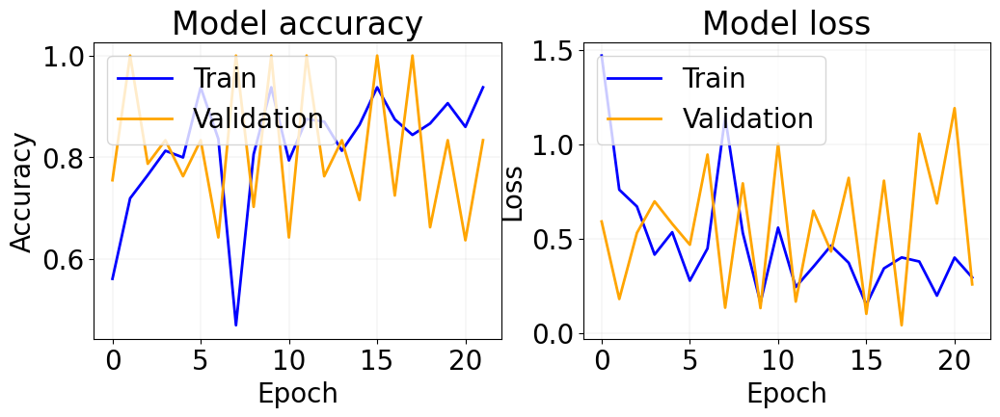

In [104]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_fusion_model.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_fusion_model.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_fusion_model.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_fusion_model.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()


#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 20s 681ms/step - accuracy: 0.7845 - loss: 0.5110
Test Loss: 0.5978329181671143
Test Accuracy: 0.7483370304107666
29/29 ━━━━━━━━━━━━━━━━━━━━ 20s 676ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.78      0.87      0.82       305
           1       0.81      0.54      0.65       305
           2       0.68      0.83      0.75       292

    accuracy                           0.75       902
   macro avg       0.76      0.75      0.74       902
weighted avg       0.76      0.75      0.74       902



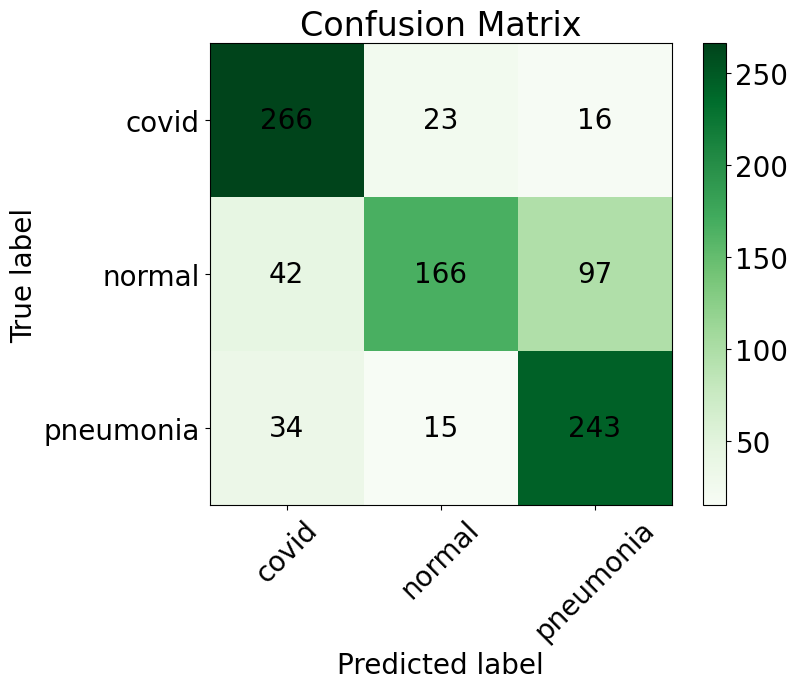

In [105]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = fusion_model.evaluate(test_generator_fusion)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(fusion_model.predict(test_generator_fusion), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_fusion.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_fusion.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_fusion.class_indices))
plt.xticks(tick_marks, test_generator_fusion.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_fusion.class_indices.keys())

for i in range(len(test_generator_fusion.class_indices)):
    for j in range(len(test_generator_fusion.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 20s 694ms/step


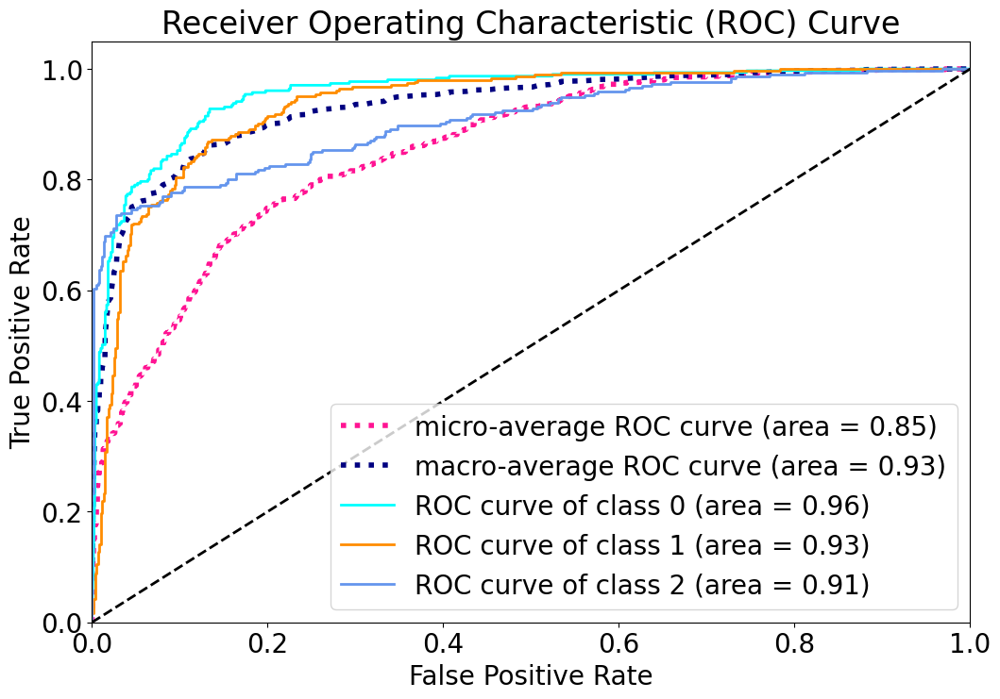

In [159]:
# Binarize the output
n_classes = len(test_generator_fusion.class_indices)
y_test = label_binarize(test_generator_fusion.classes, classes=[0, 1, 2])
y_score = fusion_model.predict(test_generator_fusion)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


### Summary of The Results with Simple CNN

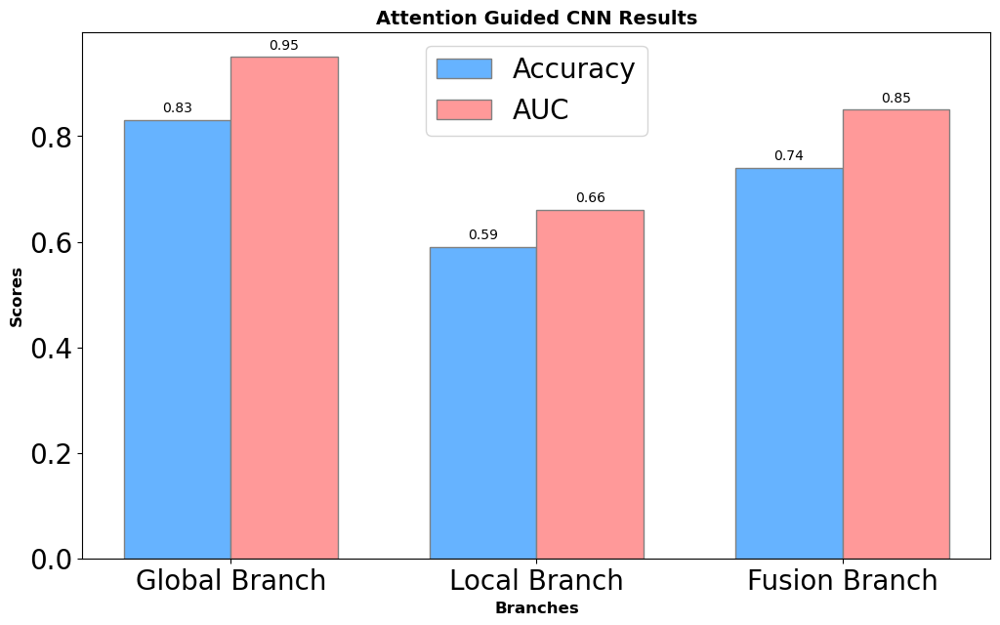

In [181]:
# Data
branches = ['Global Branch', 'Local Branch', 'Fusion Branch']
accuracies = [0.83, 0.59, 0.74]
aucs = [0.95, 0.66, 0.85]

# Bar width
bar_width = 0.35

# Positions of the bars on the x-axis
r1 = np.arange(len(branches))
r2 = [x + bar_width for x in r1]

# Colors
color_acc = '#66b3ff'
color_auc = '#ff9999'

# Create the plot
plt.figure(figsize=(12, 7))

# Bars for accuracies
bars1 = plt.bar(r1, accuracies, color=color_acc, width=bar_width, edgecolor='grey', label='Accuracy')

# Bars for AUCs
bars2 = plt.bar(r2, aucs, color=color_auc, width=bar_width, edgecolor='grey', label='AUC')

# Add labels on top of each bar
for bar in bars1:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom', fontsize=10)
for bar in bars2:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom', fontsize=10)

# Add labels
plt.xlabel('Branches', fontweight='bold', fontsize=12)
plt.ylabel('Scores', fontweight='bold', fontsize=12)
plt.title('Attention Guided CNN Results', fontweight='bold', fontsize=14)
plt.xticks([r + bar_width / 2 for r in range(len(branches))], branches)

# Add legend
plt.legend()

# Show plot
plt.show()

## Attention-Guided DenseNet

### Global Branch with DenseNet-121

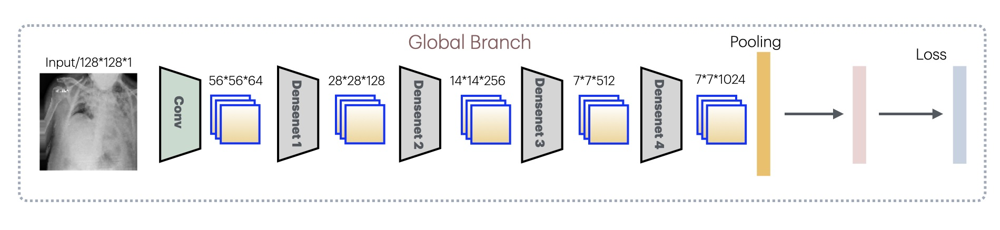

In [12]:
def densenet(input_shape, n_classes, filters=32):
    
    # Batch norm + relu + conv
    def bn_rl_conv(x, filters, kernel=1, strides=1):
        x = BatchNormalization()(x)
        x = ReLU()(x)
        x = Conv2D(filters, kernel, strides=strides, padding='same')(x)
        return x
    
    def dense_block(x, repetition):
        for _ in range(repetition):
            y = bn_rl_conv(x, 4*filters)
            y = bn_rl_conv(y, filters, 3)
            x = concatenate([y, x])
        return x
        
    def transition_layer(x):
        x = bn_rl_conv(x, tf.keras.backend.int_shape(x)[-1] // 2)
        x = AvgPool2D(2, strides=2, padding='same')(x)
        return x
    
    input = Input(input_shape)
    
    x = Conv2D(64, 7, strides=2, padding='same')(input)
    x = MaxPool2D(3, strides=2, padding='same')(x)
    
    for repetition in [6, 12, 24, 16]:
        d = dense_block(x, repetition)
        x = transition_layer(d)
    
    x = GlobalAveragePooling2D()(d)
    output = Dense(n_classes, activation='softmax')(x)
    
    model = Model(input, output)
    return model

In [49]:
input_shape = (128, 128, 1)  # Grayscale image input
n_classes = 3
densenet121 = densenet(input_shape, n_classes)

densenet121.compile(optimizer=optimizers.Adam(learning_rate=0.001),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet121.summary()



Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_484 (Conv2D) │ (None, 64, 64,    │      3,200 │ input_layer_4[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 32, 32,    │          0 │ conv2d_484[0][0]  │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        256 │ max_pooling2d_4[… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_480 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_485 (Conv2D) │ (None, 32, 32,    │      8,320 │ re_lu_480[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_485[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_481 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_486 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_481[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_232     │ (None, 32, 32,    │          0 │ conv2d_486[0][0], │
│ (Concatenate)       │ 96)               │            │ max_pooling2d_4[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        384 │ concatenate_232[… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_482 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_487 (Conv2D) │ (None, 32, 32,    │     12,416 │ re_lu_482[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_487[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_483 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_488 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_483[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_233     │ (None, 32, 32,    │          0 │ conv2d_488[0][0]

 Total params: 7,040,195 (26.86 MB)

 Trainable params: 6,958,723 (26.55 MB)

 Non-trainable params: 81,472 (318.25 KB)

#### Model Visualization

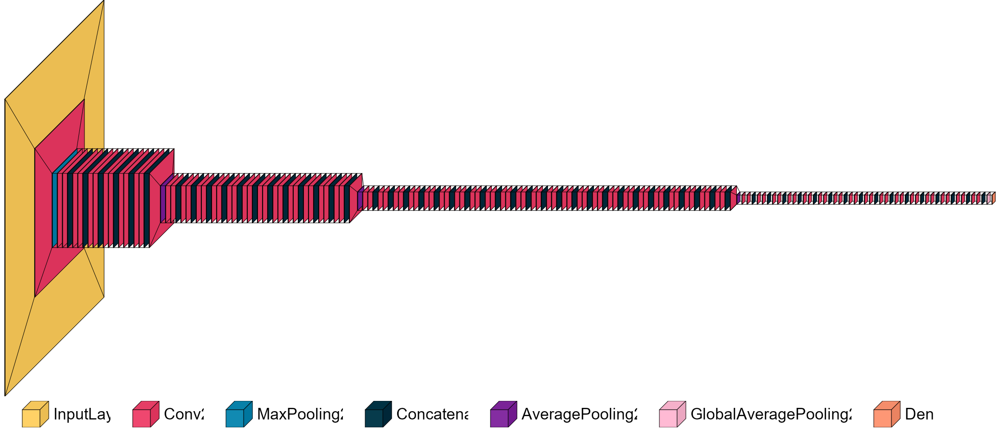

In [50]:
font = ImageFont.truetype("arial.ttf", 34)  # using comic sans is strictly prohibited!
visualkeras.layered_view(densenet121, legend=True,type_ignore=[BatchNormalization,ReLU],font=font,scale_xy=5, scale_z=1, max_z=1)  # font is optional!

####  Training The Global Branch

In [51]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

# Calculate steps per epoch
steps_per_epoch = train_generator.samples // train_generator.batch_size
validation_steps = val_generator.samples // val_generator.batch_size


start_time = time.time()

history_densenet121 = densenet121.fit(train_generator,
                           validation_data=val_generator,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet121_history.pkl', 'wb') as file:
    pickle.dump(history_densenet121.history, file)

densenet121.save('densenet121.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 336s 3s/step - accuracy: 0.5458 - loss: 1.6371 - val_accuracy: 0.3359 - val_loss: 6.0039 - learning_rate: 0.0010
Epoch 2/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step - accuracy: 0.6875 - loss: 0.7862 - val_accuracy: 0.2105 - val_loss: 6.4986 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 264s 3s/step - accuracy: 0.7156 - loss: 0.7394 - val_accuracy: 0.3661 - val_loss: 4.2806 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.8125 - loss: 0.4610 - val_accuracy: 0.1053 - val_loss: 4.6557 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 259s 3s/step - accuracy: 0.7316 - loss: 0.7041 - val_accuracy: 0.4185 - val_loss: 1.8398 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.9375 - loss: 0.3486 - val_accuracy: 0.4737 - val_loss: 1.7121 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 257s 3s/step - accuracy: 0.7817 - loss: 0.6045 - 

#### Validation Accuracy v.s. Training Accuracy

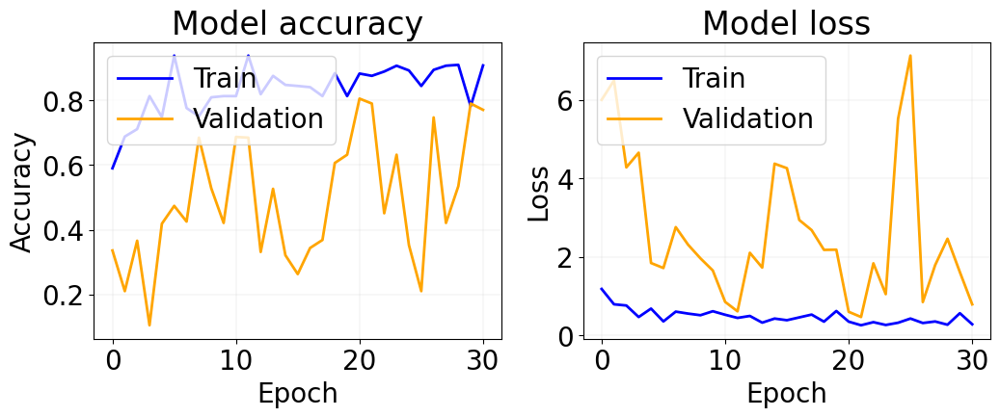

In [52]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet121.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet121.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()


#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 19s 600ms/step - accuracy: 0.8702 - loss: 0.3627
Test Loss: 0.5492427349090576
Test Accuracy: 0.8131147623062134
29/29 ━━━━━━━━━━━━━━━━━━━━ 26s 714ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.90      0.85       305
           1       0.73      0.86      0.79       305
           2       0.99      0.68      0.80       305

    accuracy                           0.81       915
   macro avg       0.84      0.81      0.81       915
weighted avg       0.84      0.81      0.81       915



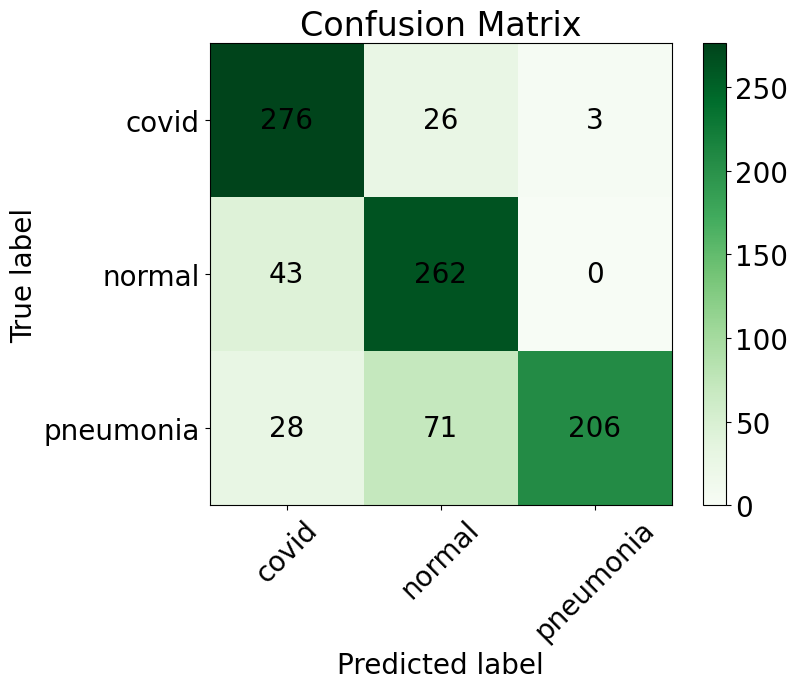

In [53]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet121.evaluate(test_generator)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet121.predict(test_generator), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator.class_indices))
plt.xticks(tick_marks, test_generator.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator.class_indices.keys())

for i in range(len(test_generator.class_indices)):
    for j in range(len(test_generator.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### Train the Model Furthermore

In [59]:
densenet121_ft = load_model('densenet121.keras')

densenet121_ft.compile(optimizer=optimizers.Adam(learning_rate=1e-5),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

####  Training The Global Branch for The Second Time

In [60]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

# Calculate steps per epoch
steps_per_epoch = train_generator.samples // train_generator.batch_size
validation_steps = val_generator.samples // val_generator.batch_size


start_time = time.time()

history_densenet121_ft = densenet121_ft.fit(train_generator,
                           validation_data=val_generator,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet121_ft_history.pkl', 'wb') as file:
    pickle.dump(history_densenet121.history, file)

densenet121.save('densenet121_ft.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 402s 4s/step - accuracy: 0.8822 - loss: 0.3316 - val_accuracy: 0.8929 - val_loss: 0.3446 - learning_rate: 1.0000e-05
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 4:41 3s/step - accuracy: 0.8438 - loss: 0.4946

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - accuracy: 0.8438 - loss: 0.4946 - val_accuracy: 0.8421 - val_loss: 0.3900 - learning_rate: 1.0000e-05
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 300s 4s/step - accuracy: 0.9141 - loss: 0.2665 - val_accuracy: 0.9040 - val_loss: 0.3102 - learning_rate: 1.0000e-05
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7812 - loss: 0.4952 - val_accuracy: 0.9474 - val_loss: 0.1846 - learning_rate: 1.0000e-05
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 292s 3s/step - accuracy: 0.9065 - loss: 0.2847 - val_accuracy: 0.8940 - val_loss: 0.3280 - learning_rate: 1.0000e-05
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 13ms/step - accuracy: 0.9688 - loss: 0.1686 - val_accuracy: 0.7895 - val_loss: 0.5955 - learning_rate: 1.0000e-05
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 307s 4s/step - accuracy: 0.9164 - loss: 0.2493 - val_accuracy: 0.8772 - val_loss: 0.3571 - learning_rate: 1.0000e-05
Epoch 8/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.9062 - los

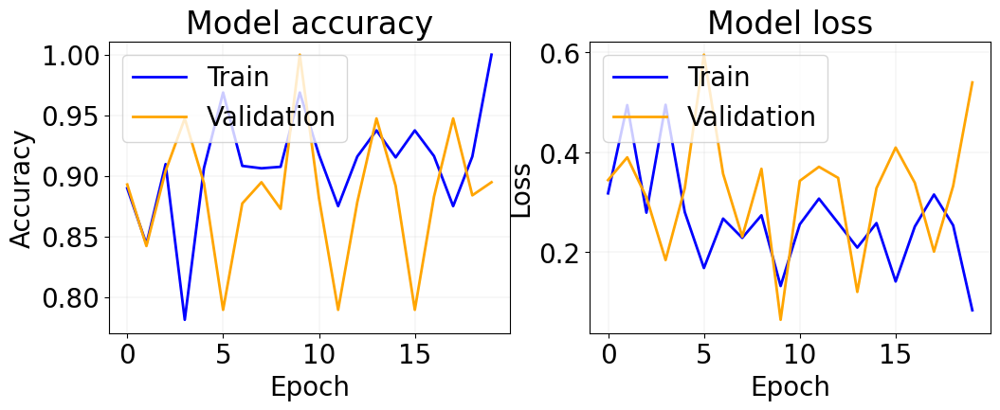

In [61]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet121_ft.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_ft.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet121_ft.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_ft.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()


#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 26s 862ms/step - accuracy: 0.9171 - loss: 0.2566
Test Loss: 0.3692075312137604
Test Accuracy: 0.8655737638473511
29/29 ━━━━━━━━━━━━━━━━━━━━ 35s 990ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.76      0.98      0.86       305
           1       0.89      0.78      0.83       305
           2       0.99      0.84      0.91       305

    accuracy                           0.87       915
   macro avg       0.88      0.87      0.87       915
weighted avg       0.88      0.87      0.87       915



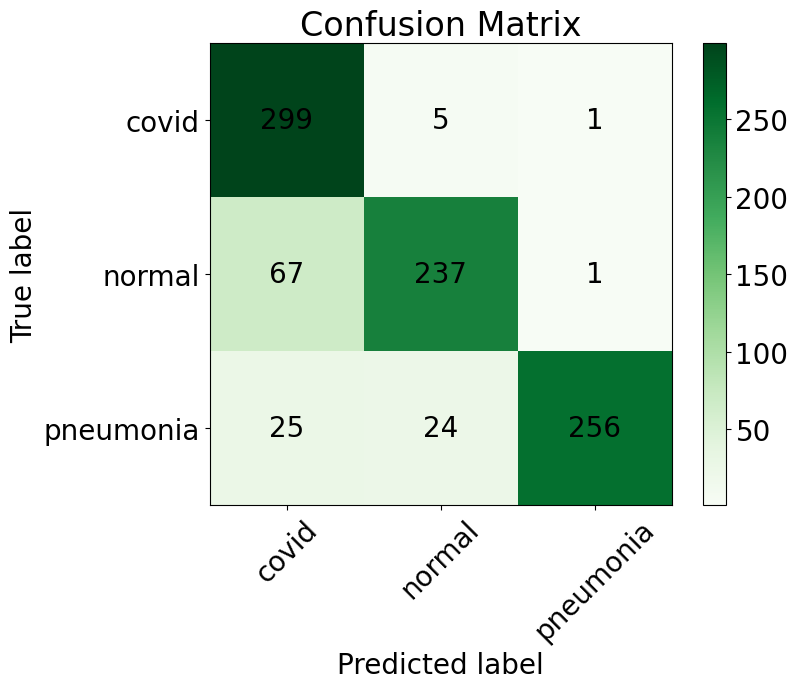

In [62]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet121_ft.evaluate(test_generator)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet121_ft.predict(test_generator), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator.class_indices))
plt.xticks(tick_marks, test_generator.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator.class_indices.keys())

for i in range(len(test_generator.class_indices)):
    for j in range(len(test_generator.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 34s 966ms/step


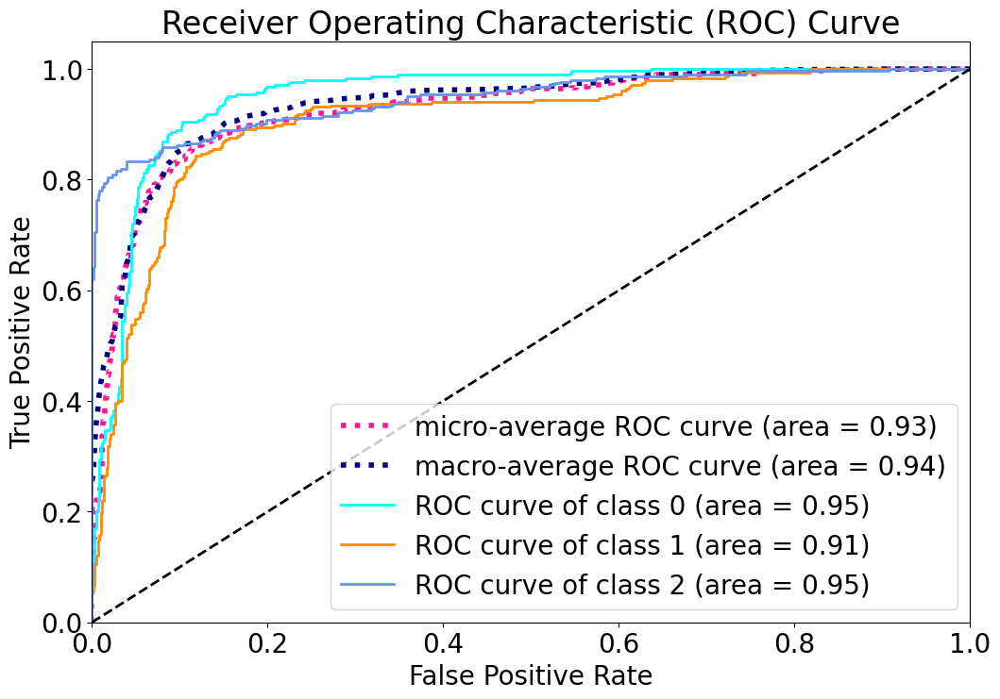

In [164]:
# Binarize the output
n_classes = len(test_generator.class_indices)
y_test = label_binarize(test_generator.classes, classes=[0, 1, 2])
y_score = densenet121_ft.predict(test_generator)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


In [2]:
global_model = load_model('densenet121_ft.keras')

global_model.summary()

Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_484 (Conv2D) │ (None, 64, 64,    │      3,200 │ input_layer_4[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 32, 32,    │          0 │ conv2d_484[0][0]  │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        256 │ max_pooling2d_4[… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_480 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_485 (Conv2D) │ (None, 32, 32,    │      8,320 │ re_lu_480[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_485[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_481 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_486 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_481[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_232     │ (None, 32, 32,    │          0 │ conv2d_486[0][0], │
│ (Concatenate)       │ 96)               │            │ max_pooling2d_4[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        384 │ concatenate_232[… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_482 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_487 (Conv2D) │ (None, 32, 32,    │     12,416 │ re_lu_482[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_487[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_483 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_488 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_483[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_233     │ (None, 32, 32,    │          0 │ conv2d_488[0][0]

 Total params: 20,957,643 (79.95 MB)

 Trainable params: 6,958,723 (26.55 MB)

 Non-trainable params: 81,472 (318.25 KB)

 Optimizer params: 13,917,448 (53.09 MB)

### Mask Inference with DenseNet-121

In [41]:
def get_heatmap(images, model, last_conv_layer_name, pred_index=None):

    last_conv_layer = model.get_layer(last_conv_layer_name)
    last_conv_layer_model = tf.keras.Model(inputs=global_model.input, outputs=last_conv_layer.output)
    conv_output = last_conv_layer_model(images, training=False)
    
    heatmap = tf.reduce_max(tf.abs(conv_output), axis=-1)
    
    heatmap = tf.maximum(heatmap, 0)
    heatmap /= (np.max(heatmap) + 1e-7)  # Add epsilon to avoid division by zero

    return heatmap

def attention_guided_mask_inference_batch(generator, model, last_conv_layer_name='conv2d_9'):
    """
    Generate attention masks using Grad-CAM for a batch of images from the generator.

    :param generator: Data generator providing images and labels.
    :param model: The trained model.
    :param last_conv_layer_name: The name of the last convolutional layer.
    :return: Tuple of masks and images.
    """
    masks = []

    images, _ = next(generator)
    for img in images:
        img = tf.expand_dims(img, axis=0)  # Add batch dimension
#         heatmap = get_grad_cam_heatmap(img, model, last_conv_layer_name)
        heatmap = get_heatmap(img, model, last_conv_layer_name)
        if heatmap is None:
            continue

        # Generate binary masks
        threshold = 0.7  # you may need to adjust this value
        mask = heatmap > threshold
        masks.append(tf.cast(mask, tf.float32))  # Change here: use tf.cast instead of astype

    masks = tf.convert_to_tensor(masks, dtype=tf.float32)
    masks = tf.expand_dims(masks, axis=-1)  # Add channel dimension

    return masks, images  # Return masks and original images

def crop_local_region_batch(images, masks, input_shape=(128, 128)):
    cropped_images = []
    for i in range(images.shape[0]):
        if i >= len(masks):  # Check if the index is within bounds of masks
            continue

        # Resize the mask to match the input image dimensions
        mask = masks[i].numpy().astype(np.uint8)  # Ensure mask is a numpy array
        if mask.size == 0:
            continue

        # Remove extra dimensions from the mask
        mask = np.squeeze(mask)

        # Check the shape of the mask before resizing
        #print(f"Mask shape before resizing: {mask.shape}")

        mask = cv2.resize(mask, (input_shape[1], input_shape[0]))  # Resize to (width, height)

        # Check the shape of the mask after resizing
        #print(f"Mask shape after resizing: {mask.shape}")

        image = images[i]
        if isinstance(image, tf.Tensor):
            image = image.numpy()  # Convert tensor to numpy array if needed

        # Check the shape of the image
        #print(f"Image shape: {image.shape}")

        # Find contours in the resized mask
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if len(contours) == 0:
            cropped_image = cv2.resize(image, (input_shape[1], input_shape[0]))  # Resize the entire image if no contours found
            cropped_images.append(cropped_image)
            continue

        # Find the largest contour by area
        largest_contour = max(contours, key=cv2.contourArea)

        # Crop the image using the bounding box of the largest contour
        x, y, w, h = cv2.boundingRect(largest_contour)
        cropped_image = image[y:y+h, x:x+w]
        cropped_image = cv2.resize(cropped_image, (input_shape[1], input_shape[0]))  # Resize to (width, height)
        cropped_images.append(cropped_image)

    cropped_images = np.array(cropped_images)
    cropped_images = np.expand_dims(cropped_images, axis=-1)  # Add channel dimension
    return tf.convert_to_tensor(cropped_images, dtype=tf.float32)


def save_cropped_images_to_directory(generator, model, output_dir, subset, last_conv_layer_name='concatenate_289'):
    original_images_dir = os.path.join(output_dir, f'{subset}_original')
    cropped_images_dir = os.path.join(output_dir, f'{subset}_cropped')

    classes = ["covid", "normal", "pneumonia"]
    os.makedirs(original_images_dir, exist_ok=True)
    os.makedirs(cropped_images_dir, exist_ok=True)

    # Reset the generator
    generator.reset()

    total_samples = 0

    while total_samples < generator.samples:
        # Get the next batch of images and labels
        images, labels = next(generator)
        # Generate masks and original images from the generator batch
        masks, _ = attention_guided_mask_inference_batch(generator, model, last_conv_layer_name)
        # Generate cropped images using the masks
        cropped_images = crop_local_region_batch(images, masks)

        for i, (original_img, cropped_img, label) in enumerate(zip(images, cropped_images, labels)):
            class_name = classes[int(label)]
            orig_class_dir = os.path.join(original_images_dir, class_name)
            crop_class_dir = os.path.join(cropped_images_dir, class_name)
            os.makedirs(orig_class_dir, exist_ok=True)
            os.makedirs(crop_class_dir, exist_ok=True)

            orig_img_path = os.path.join(orig_class_dir, f"{total_samples + i}.png")
            crop_img_path = os.path.join(crop_class_dir, f"{total_samples + i}.png")

            # Rescale images back to 0-255 before saving
            original_img = (original_img * 255).astype(np.uint8)
            cropped_img = (cropped_img.numpy() * 255).astype(np.uint8)

            cv2.imwrite(orig_img_path, original_img.squeeze())
            cv2.imwrite(crop_img_path, cropped_img.squeeze())

        total_samples += len(images)


def plot_samples_with_masks_and_crops(generator, model, num_samples=5, last_conv_layer_name='conv2d_9'):
    """
    Plot original images with masks overlayed and their corresponding cropped images using a generator.

    :param generator: The data generator.
    :param model: The trained model.
    :param num_samples: Number of samples to plot.
    :param last_conv_layer_name: The name of the last convolutional layer.
    """
    classes = ["covid", "normal", "pneumonia"]

    # Get a batch of images and labels from the generator
    batch_images, batch_labels = next(generator)
    num_samples = min(num_samples, len(batch_images))

    # Generate masks and original images from the generator batch
    masks, _ = attention_guided_mask_inference_batch(generator, model, last_conv_layer_name)
    cropped_images = crop_local_region_batch(batch_images, masks)

    # Make predictions on the batch images
    predictions = model.predict(batch_images)
    predicted_labels = np.argmax(predictions, axis=1)

    plt.figure(figsize=(20, num_samples * 5))

    for i in range(num_samples):
        original_img = batch_images[i].squeeze()
        mask = masks[i].numpy().squeeze()
        cropped_img = cropped_images[i].numpy().squeeze()
        true_label = classes[int(batch_labels[i])]
        predicted_label = classes[int(predicted_labels[i])]

        # Resize the CAM to the original image size
        heatmap = cv2.resize(mask, (original_img.shape[1], original_img.shape[0]))
        heatmap = np.uint8(255 * heatmap)
        # Apply a colormap to the heatmap
        heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

        # Overlay the heatmap on the original image
        alpha = 0.3
        superimposed_img = cv2.addWeighted(cv2.cvtColor((original_img * 255).astype('uint8'), cv2.COLOR_GRAY2BGR), 1 - alpha, heatmap_colored, alpha, 0)

        plt.subplot(num_samples, 4, i * 4 + 1)
        plt.imshow(original_img, cmap='gray')
        plt.title(f"Original: {true_label}")
        plt.axis('off')

        plt.subplot(num_samples, 4, i * 4 + 2)
        plt.imshow(heatmap_colored)
        plt.title(f"Mask: {true_label}")
        plt.axis('off')

        plt.subplot(num_samples, 4, i * 4 + 3)
        plt.imshow(superimposed_img)
        plt.title('Mask Overlayed')
        plt.axis('off')

        plt.subplot(num_samples, 4, i * 4 + 4)
        plt.imshow(cropped_img, cmap='gray')
        plt.title(f"True Label: {true_label}\nPredicted Label: {predicted_label}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


#### Some Samples from  The Generated Masks and Cropped Images

C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\legacy\preprocessing\image.py:1263: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(
C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\legacy\preprocessing\image.py:1273: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


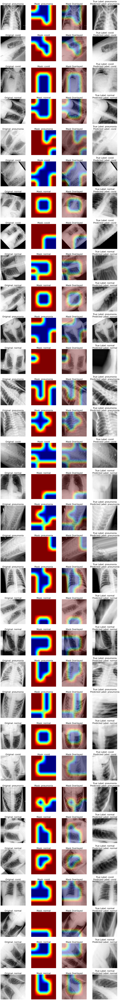

In [71]:
# Example of plotting using the train_generator and global_model
plot_samples_with_masks_and_crops(train_generator, global_model, num_samples=32, last_conv_layer_name='concatenate_289')

#### Saving The Cropped Images

In [38]:
# Now you can use this function with the data generators
save_cropped_images_to_directory(train_generator, global_model, output_dir, 'train')
save_cropped_images_to_directory(val_generator, global_model, output_dir, 'validation')
save_cropped_images_to_directory(test_generator, global_model, output_dir, 'test')

print(f"Original and cropped images have been organized and saved to {output_dir}")

Original and cropped images have been organized and saved to ./organized_data/


### Create The Local Dataset with DenseNet-121

In [165]:
# output_dir = '/content/drive/MyDrive/HDA/organized_data/'
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_dir = os.path.join(output_dir, 'train_cropped')
val_dir = os.path.join(output_dir, 'validation_cropped')
test_dir = os.path.join(output_dir, 'test_cropped')

datagen_train_local = ImageDataGenerator(rescale=1./255)

datagen_val_local = ImageDataGenerator(rescale=1./255)

# Create generators for training and validation data
train_generator_local = datagen_train_local.flow_from_directory(
    directory=train_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

val_generator_local = datagen_val_local.flow_from_directory(
    directory=val_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

test_generator_local = datagen_val_local.flow_from_directory(
    directory=test_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=False
)


Found 2738 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.


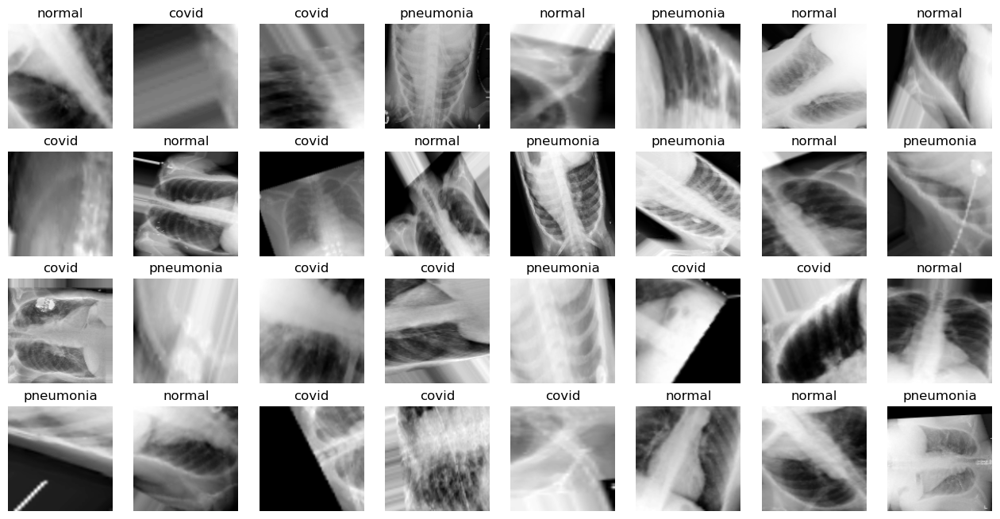

In [44]:
classes = ["covid", "normal", "pneumonia"]
plt.rcParams.update({'font.size': 10})

# Get a batch of images and labels from the validation generator
batch_images, batch_labels = next(train_generator_local)

# Function to plot images
def plot_images(images, labels, class_names, n_cols=8):
    n_rows = len(images) // n_cols + (len(images) % n_cols != 0)
    plt.figure(figsize=(16, 2 * n_rows))
    for i in range(len(images)):
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(images[i],cmap='gray')
        plt.title(class_names[int(labels[i])])
        plt.axis('off')

    plt.show()

# Plot some images from the validation set
plot_images(batch_images, batch_labels, classes)


### Local Branch with DenseNet-121

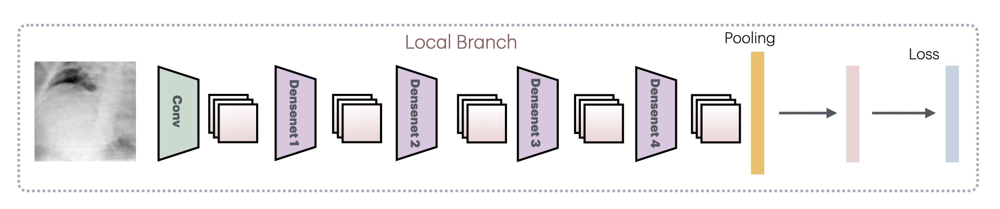

In [45]:
input_shape = (128, 128, 1)  # Grayscale image input
n_classes = 3
densenet121_local = densenet(input_shape, n_classes)

densenet121_local.compile(optimizer=optimizers.Adam(learning_rate=0.001),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet121_local.summary()

Model: "functional_18665"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_363 (Conv2D) │ (None, 64, 64,    │      3,200 │ input_layer_3[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 32, 32,    │          0 │ conv2d_363[0][0]  │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        256 │ max_pooling2d_3[… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_360 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_364 (Conv2D) │ (None, 32, 32,    │      8,320 │ re_lu_360[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_364[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_361 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_365 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_361[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_175     │ (None, 32, 32,    │          0 │ conv2d_365[0][0], │
│ (Concatenate)       │ 96)               │            │ max_pooling2d_3[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        384 │ concatenate_175[… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_362 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_366 (Conv2D) │ (None, 32, 32,    │     12,416 │ re_lu_362[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_366[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_363 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_367 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_363[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_176     │ (None, 32, 32,    │          0 │ conv2d_367[0][0]

 Total params: 7,040,195 (26.86 MB)

 Trainable params: 6,958,723 (26.55 MB)

 Non-trainable params: 81,472 (318.25 KB)

#### Training The Local Branch

In [46]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

# Calculate steps per epoch
steps_per_epoch = train_generator_local.samples // train_generator_local.batch_size
validation_steps = val_generator_local.samples // val_generator_local.batch_size


start_time = time.time()

history_densenet121_local = densenet121_local.fit(train_generator_local,
                           validation_data=val_generator_local,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet121_history_local.pkl', 'wb') as file:
    pickle.dump(history_densenet121_local.history, file)

densenet121_local.save('densenet121_local.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 362s 3s/step - accuracy: 0.4253 - loss: 2.0161 - val_accuracy: 0.3326 - val_loss: 1.7093 - learning_rate: 0.0010
Epoch 2/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step - accuracy: 0.5625 - loss: 1.3689 - val_accuracy: 0.5000 - val_loss: 0.7258 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 267s 3s/step - accuracy: 0.5092 - loss: 1.1249 - val_accuracy: 0.3359 - val_loss: 2.9250 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.4375 - loss: 1.2312 - val_accuracy: 0.1667 - val_loss: 4.4193 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 261s 3s/step - accuracy: 0.5041 - loss: 1.0960 - val_accuracy: 0.3929 - val_loss: 1.3950 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.5625 - loss: 0.8090 - val_accuracy: 0.5000 - val_loss: 0.9229 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.5599 - loss: 0.9452
Epoch 

#### Validation v.s. Training Accuracy

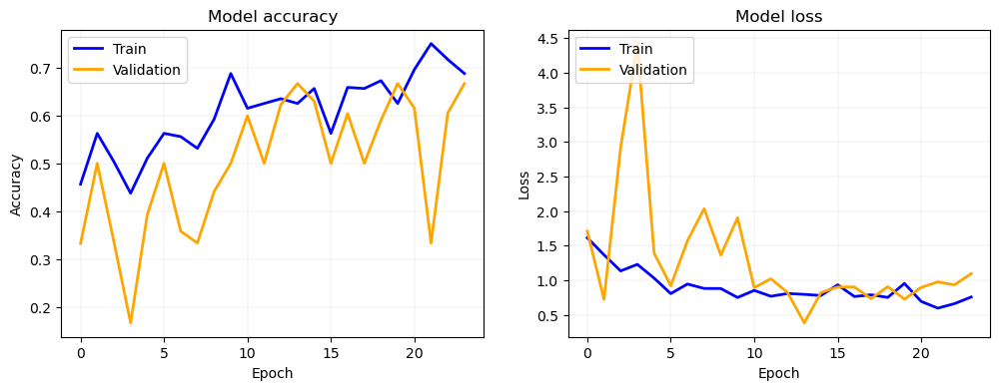

In [47]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet121_local.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_local.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet121_local.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_local.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()

#### Test Accuracy

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 721ms/step - accuracy: 0.4579 - loss: 1.0393
Test Loss: 0.7878637909889221
Test Accuracy: 0.6496673822402954
29/29 ━━━━━━━━━━━━━━━━━━━━ 30s 819ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.76      0.26      0.39       305
           1       0.66      0.86      0.75       305
           2       0.61      0.84      0.71       292

    accuracy                           0.65       902
   macro avg       0.68      0.65      0.61       902
weighted avg       0.68      0.65      0.61       902



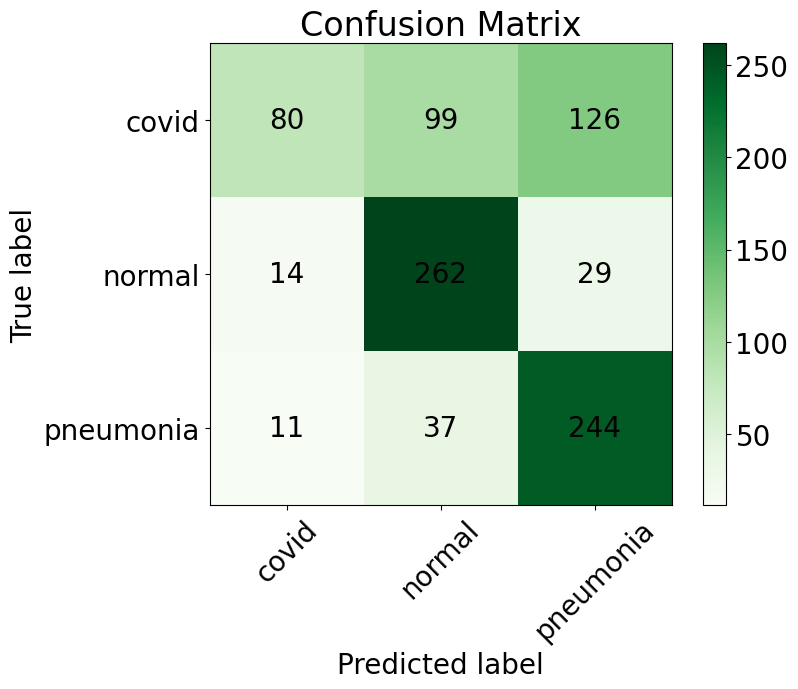

In [48]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet121_local.evaluate(test_generator_local)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet121_local.predict(test_generator_local), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_local.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_local.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_local.class_indices))
plt.xticks(tick_marks, test_generator_local.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_local.class_indices.keys())

for i in range(len(test_generator_local.class_indices)):
    for j in range(len(test_generator_local.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### Training The Local Branch Furthermore

In [49]:
densenet121_local_ft = load_model('densenet121_local.keras')

densenet121_local_ft.compile(optimizer=optimizers.Adam(learning_rate=1e-5),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet121_local_ft.summary()

Model: "functional_18665"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_363 (Conv2D) │ (None, 64, 64,    │      3,200 │ input_layer_3[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 32, 32,    │          0 │ conv2d_363[0][0]  │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        256 │ max_pooling2d_3[… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_360 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_364 (Conv2D) │ (None, 32, 32,    │      8,320 │ re_lu_360[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_364[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_361 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_365 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_361[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_175     │ (None, 32, 32,    │          0 │ conv2d_365[0][0], │
│ (Concatenate)       │ 96)               │            │ max_pooling2d_3[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        384 │ concatenate_175[… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_362 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_366 (Conv2D) │ (None, 32, 32,    │     12,416 │ re_lu_362[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_366[0][0]  │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_363 (ReLU)    │ (None, 32, 32,    │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_367 (Conv2D) │ (None, 32, 32,    │     36,896 │ re_lu_363[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_176     │ (None, 32, 32,    │          0 │ conv2d_367[0][0]

 Total params: 7,040,195 (26.86 MB)

 Trainable params: 6,958,723 (26.55 MB)

 Non-trainable params: 81,472 (318.25 KB)

#### Training for The Second Time

In [50]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

# Calculate steps per epoch
steps_per_epoch = train_generator_local.samples // train_generator_local.batch_size
validation_steps = val_generator_local.samples // val_generator_local.batch_size


start_time = time.time()

history_densenet121_local_ft = densenet121_local_ft.fit(train_generator_local,
                           validation_data=val_generator_local,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet121_history_local_ft.pkl', 'wb') as file:
    pickle.dump(history_densenet121_local_ft.history, file)

densenet121_local_ft.save('densenet121_local_ft.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 379s 4s/step - accuracy: 0.6644 - loss: 0.7694 - val_accuracy: 0.6674 - val_loss: 0.7509 - learning_rate: 1.0000e-05
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 4:20 3s/step - accuracy: 0.6250 - loss: 0.8309

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - accuracy: 0.6250 - loss: 0.8309 - val_accuracy: 1.0000 - val_loss: 0.4422 - learning_rate: 1.0000e-05
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 281s 3s/step - accuracy: 0.6789 - loss: 0.7520 - val_accuracy: 0.6931 - val_loss: 0.7187 - learning_rate: 1.0000e-05
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.6562 - loss: 0.7252 - val_accuracy: 1.0000 - val_loss: 0.3193 - learning_rate: 1.0000e-05
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 270s 3s/step - accuracy: 0.6716 - loss: 0.7502 - val_accuracy: 0.7009 - val_loss: 0.7051 - learning_rate: 1.0000e-05
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7188 - loss: 0.7784 - val_accuracy: 0.5000 - val_loss: 1.4829 - learning_rate: 1.0000e-05
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 276s 3s/step - accuracy: 0.6829 - loss: 0.7455 - val_accuracy: 0.7076 - val_loss: 0.7004 - learning_rate: 1.0000e-05
Epoch 8/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.5000 - loss: 

#### Validation Accuracy v.s. Training Accuracy

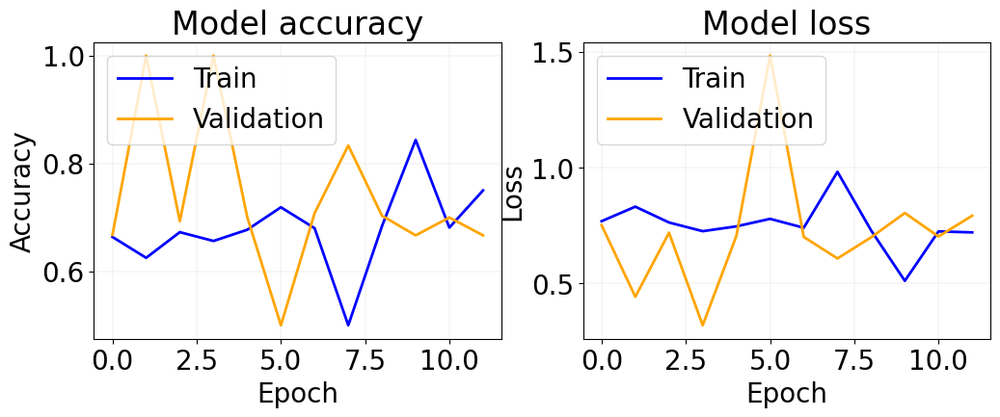

In [51]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet121_local_ft.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_local_ft.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet121_local_ft.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_local_ft.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()

#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 706ms/step - accuracy: 0.5804 - loss: 0.8728
Test Loss: 0.716158926486969
Test Accuracy: 0.7039911150932312
29/29 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step 
Classification Report:
               precision    recall  f1-score   support

           0       0.74      0.44      0.55       305
           1       0.69      0.89      0.77       305
           2       0.70      0.79      0.74       292

    accuracy                           0.70       902
   macro avg       0.71      0.71      0.69       902
weighted avg       0.71      0.70      0.69       902



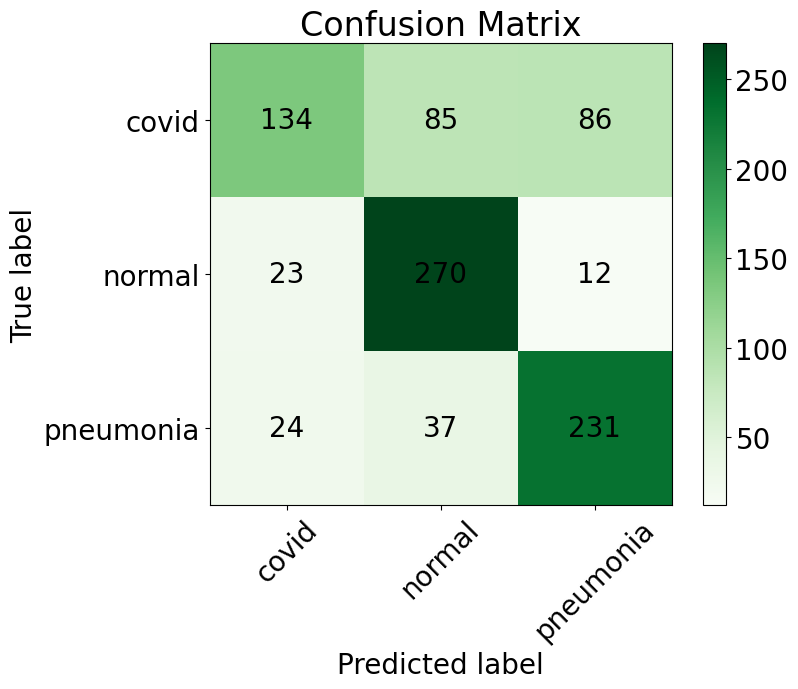

In [52]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet121_local_ft.evaluate(test_generator_local)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet121_local_ft.predict(test_generator_local), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_local.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_local.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_local.class_indices))
plt.xticks(tick_marks, test_generator_local.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_local.class_indices.keys())

for i in range(len(test_generator_local.class_indices)):
    for j in range(len(test_generator_local.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


29/29 ━━━━━━━━━━━━━━━━━━━━ 24s 816ms/step


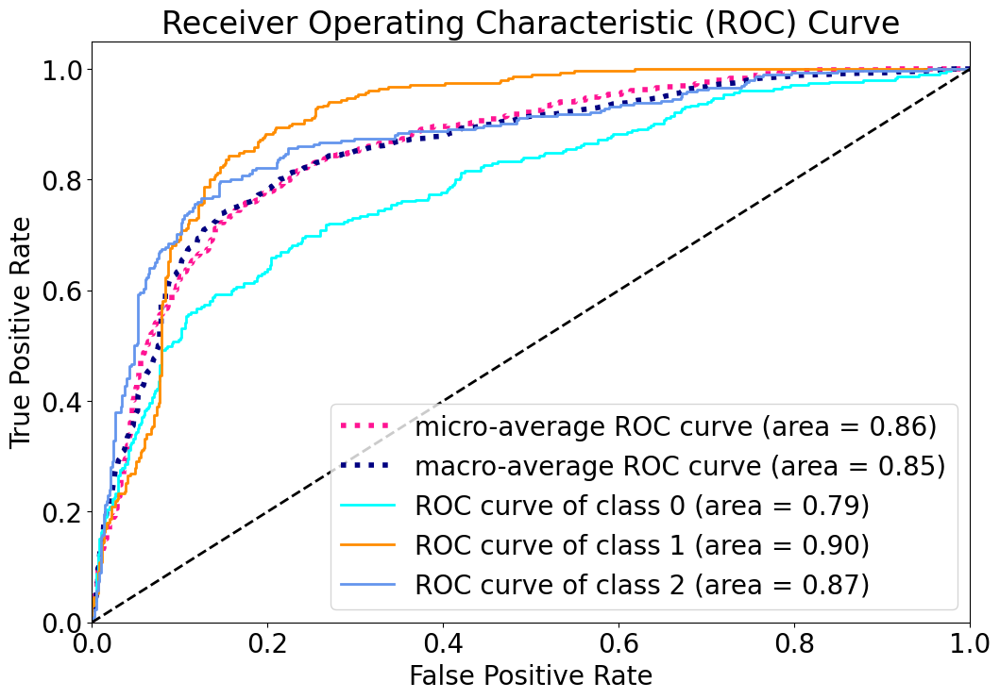

In [166]:
# Binarize the output
n_classes = len(test_generator_local.class_indices)
y_test = label_binarize(test_generator_local.classes, classes=[0, 1, 2])
y_score = densenet121_local_ft.predict(test_generator_local)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


### Create Fusion Dataset with DenseNet-121

In [106]:
class DualImageDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, global_dir, local_dir, batch_size, target_size=(128, 128), color_mode='grayscale', class_mode='sparse'):
        self.global_dir = global_dir
        self.local_dir = local_dir
        self.batch_size = batch_size
        self.target_size = target_size
        self.color_mode = color_mode
        self.class_mode = class_mode
        self.global_datagen = ImageDataGenerator(rescale=1./255)
        self.local_datagen = ImageDataGenerator(rescale=1./255)

        self.global_generator = self.global_datagen.flow_from_directory(
            directory=self.global_dir,
            target_size=self.target_size,
            batch_size=self.batch_size,
            color_mode=self.color_mode,
            class_mode=self.class_mode,
            shuffle=False
        )

        self.local_generator = self.local_datagen.flow_from_directory(
            directory=self.local_dir,
            target_size=self.target_size,
            batch_size=self.batch_size,
            color_mode=self.color_mode,
            class_mode=self.class_mode,
            shuffle=False
        )
        
        self.classes = self.global_generator.classes

    def __len__(self):
        return len(self.global_generator)

    def __getitem__(self, index):
        global_images, labels = self.global_generator[index]
        local_images, _ = self.local_generator[index]
        return (global_images, local_images), labels

    def on_epoch_end(self):
        pass  # No need to shuffle, so we can remove the shuffling logic

    @property
    def class_indices(self):
        return self.global_generator.class_indices

In [107]:
# output_dir = '/content/drive/MyDrive/HDA/organized_data/'
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_global_dir = os.path.join(output_dir, 'train_original')
train_local_dir = os.path.join(output_dir, 'train_cropped')
val_global_dir = os.path.join(output_dir, 'validation_original')
val_local_dir = os.path.join(output_dir, 'validation_cropped')
test_global_dir = os.path.join(output_dir, 'test_original')
test_local_dir = os.path.join(output_dir, 'test_cropped')

In [108]:
# Create custom data generators for training and validation data
train_generator_fusion = DualImageDataGenerator(train_global_dir, train_local_dir, batch_size=32)
val_generator_fusion = DualImageDataGenerator(val_global_dir, val_local_dir, batch_size=32)
test_generator_fusion = DualImageDataGenerator(test_global_dir, test_local_dir, batch_size=32)

Found 2738 images belonging to 3 classes.
Found 2738 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.


#### Plot Some Samples

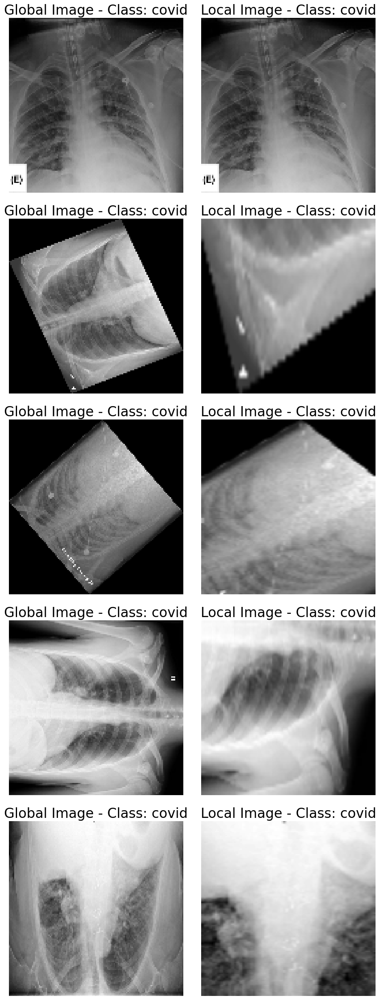

In [109]:
def plot_samples_from_dual_generator(generator, num_samples=5):
    """
    Plot samples from the DualImageDataGenerator to ensure global and local images belong to each other.

    :param generator: Instance of DualImageDataGenerator.
    :param num_samples: Number of samples to plot.
    """
    classes = list(generator.global_generator.class_indices.keys())
    total_samples_plotted = 0
    batch_index = 0
    
    plt.figure(figsize=(10, num_samples * 5))
    
    while total_samples_plotted < num_samples:
        (global_images, local_images), labels = generator[batch_index]
        batch_index += 1

        for j in range(len(global_images)):
            if total_samples_plotted >= num_samples:
                break
                
            global_img = global_images[j].squeeze()
            local_img = local_images[j].squeeze()
            label = classes[int(labels[j])]

            plt.subplot(num_samples, 2, total_samples_plotted * 2 + 1)
            plt.imshow(global_img, cmap='gray')
            plt.title(f"Global Image - Class: {label}")
            plt.axis('off')

            plt.subplot(num_samples, 2, total_samples_plotted * 2 + 2)
            plt.imshow(local_img, cmap='gray')
            plt.title(f"Local Image - Class: {label}")
            plt.axis('off')

            total_samples_plotted += 1
    
    plt.tight_layout()
    plt.show()

# Example usage of the plot function
plot_samples_from_dual_generator(test_generator_fusion, num_samples=5)


### Fusion Branch with DenseNet-121

In [110]:
# Load the pre-trained global and local models
global_branch = load_model('densenet121_ft.keras')
local_branch = load_model('densenet121_local_ft.keras')

#### Rename The Layers

In [111]:
# Function to rename the layers of a model
def rename_model_layers(model, prefix):
    config = model.get_config()
    for layer in config['layers']:
        layer['config']['name'] = prefix + layer['config']['name']
    new_model = Model.from_config(config)
    new_model.set_weights(model.get_weights())
    return new_model
# Rename the layers of the global and local models
global_branch = rename_model_layers(global_branch, 'global_')
local_branch = rename_model_layers(local_branch, 'local_')


In [112]:
global_branch.summary()

Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ global_input_layer… │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_484   │ (None, 64, 64,    │      3,200 │ global_input_lay… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_max_pooling… │ (None, 32, 32,    │          0 │ global_conv2d_48… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │        256 │ global_max_pooli… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_re_lu_480    │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (ReLU)              │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_485   │ (None, 32, 32,    │      8,320 │ global_re_lu_480… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │        512 │ global_conv2d_48… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_re_lu_481    │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (ReLU)              │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_486   │ (None, 32, 32,    │     36,896 │ global_re_lu_481… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_concatenate… │ (None, 32, 32,    │          0 │ global_conv2d_48… │
│ (Concatenate)       │ 96)               │            │ global_max_pooli… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │        384 │ global_concatena… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_re_lu_482    │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_487   │ (None, 32, 32,    │     12,416 │ global_re_lu_482… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │        512 │ global_conv2d_48… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_re_lu_483    │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (ReLU)              │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_488   │ (None, 32, 32,    │     36,896 │ global_re_lu_483… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_concatenate… │ (None, 32, 32,    │          0 │ global_conv2d_48

 Total params: 7,040,195 (26.86 MB)

 Trainable params: 6,958,723 (26.55 MB)

 Non-trainable params: 81,472 (318.25 KB)

In [113]:
local_branch.summary()

Model: "functional_18665"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ local_input_layer_3 │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_363    │ (None, 64, 64,    │      3,200 │ local_input_laye… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_max_pooling2… │ (None, 32, 32,    │          0 │ local_conv2d_363… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 32, 32,    │        256 │ local_max_poolin… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_re_lu_360     │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (ReLU)              │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_364    │ (None, 32, 32,    │      8,320 │ local_re_lu_360[… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 32, 32,    │        512 │ local_conv2d_364… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_re_lu_361     │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (ReLU)              │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_365    │ (None, 32, 32,    │     36,896 │ local_re_lu_361[… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_concatenate_… │ (None, 32, 32,    │          0 │ local_conv2d_365… │
│ (Concatenate)       │ 96)               │            │ local_max_poolin… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 32, 32,    │        384 │ local_concatenat… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_re_lu_362     │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_366    │ (None, 32, 32,    │     12,416 │ local_re_lu_362[… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 32, 32,    │        512 │ local_conv2d_366… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_re_lu_363     │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (ReLU)              │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_367    │ (None, 32, 32,    │     36,896 │ local_re_lu_363[… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_concatenate_… │ (None, 32, 32,    │          0 │ local_conv2d_367

 Total params: 7,040,195 (26.86 MB)

 Trainable params: 6,958,723 (26.55 MB)

 Non-trainable params: 81,472 (318.25 KB)

#### Freeze The Global & Local Branch

In [114]:
# Freeze the layers in the global and local models
for layer in global_branch.layers:
    layer.trainable = False

for layer in local_branch.layers:
    layer.trainable = False

In [117]:
# Create the fusion model

def create_fusion_model(global_model, local_model):

    # Take the outputs of the last pooling layers
    global_output = global_model.get_layer('global_global_average_pooling2d_4').output
    local_output = local_model.get_layer('local_global_average_pooling2d_3').output

    # Concatenate the outputs of the global and local branches
    combined_input = layers.concatenate([global_output, local_output])

    # Add a fully connected layer and the final output layer
    #x = layers.Dense(512, activation='relu')(combined_input)
    #x = layers.Dense(64, activation='relu')
    x = layers.Dense(3, activation='softmax')(combined_input)

    model = models.Model(inputs=[global_model.input, local_model.input], outputs=x)
    return model


densenet_fusion_model = create_fusion_model(global_branch, local_branch)
densenet_fusion_model.compile(optimizer=optimizers.Adam(1e-3),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet_fusion_model.summary()

Model: "functional_19191"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ global_input_layer… │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_input_layer_3 │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_484   │ (None, 64, 64,    │      3,200 │ global_input_lay… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_363    │ (None, 64, 64,    │      3,200 │ local_input_laye… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_max_pooling… │ (None, 32, 32,    │          0 │ global_conv2d_48… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_max_pooling2… │ (None, 32, 32,    │          0 │ local_conv2d_363… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │        256 │ global_max_pooli… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 32, 32,    │        256 │ local_max_poolin… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_re_lu_480    │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (ReLU)              │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_re_lu_360     │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (ReLU)              │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_485   │ (None, 32, 32,    │      8,320 │ global_re_lu_480… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_364    │ (None, 32, 32,    │      8,320 │ local_re_lu_360[… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_batch_norma… │ (None, 32, 32,    │        512 │ global_conv2d_48… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_batch_normal… │ (None, 32, 32,    │        512 │ local_conv2d_364… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_re_lu_481    │ (None, 32, 32,    │          0 │ global_batch_nor… │
│ (ReLU)              │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_re_lu_361     │ (None, 32, 32,    │          0 │ local_batch_norm… │
│ (ReLU)              │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_486   │ (None, 32, 32,    │     36,896 │ global_re_lu_481

 Total params: 14,080,387 (53.71 MB)

 Trainable params: 6,147 (24.01 KB)

 Non-trainable params: 14,074,240 (53.69 MB)

#### Traing The Fusion Branch 

In [118]:
# Define callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-4,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

steps_per_epoch = 2738 // 32
validation_steps = 902 // 32

start_time = time.time()

history_densenet_fusion_model = densenet_fusion_model.fit(train_generator_fusion,
                           validation_data=val_generator_fusion,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet_fusion_model_history.pkl', 'wb') as file:
    pickle.dump(history_densenet_fusion_model.history, file)

densenet_fusion_model.save('densenet_fusion_model.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100


C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


85/85 ━━━━━━━━━━━━━━━━━━━━ 337s 4s/step - accuracy: 0.7097 - loss: 0.6963 - val_accuracy: 0.8248 - val_loss: 0.4654 - learning_rate: 0.0010
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 1:27 1s/step - accuracy: 0.8750 - loss: 0.5940

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 68ms/step - accuracy: 0.8750 - loss: 0.5940 - val_accuracy: 0.6667 - val_loss: 0.5913 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 262s 3s/step - accuracy: 0.8453 - loss: 0.4269 - val_accuracy: 0.8650 - val_loss: 0.3986 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.9688 - loss: 0.2234 - val_accuracy: 0.6667 - val_loss: 1.1316 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 272s 3s/step - accuracy: 0.8640 - loss: 0.3921 - val_accuracy: 0.8661 - val_loss: 0.4043 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - accuracy: 0.7500 - loss: 0.7361 - val_accuracy: 0.6667 - val_loss: 1.3165 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 267s 3s/step - accuracy: 0.8703 - loss: 0.3504 - val_accuracy: 0.8705 - val_loss: 0.4051 - learning_rate: 0.0010
Epoch 8/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 1:27 1s/step - accuracy: 0.9688 - loss: 0.2057
Epoch 8: Reduc

#### Validation Accuracy v.s. Training Accuracy

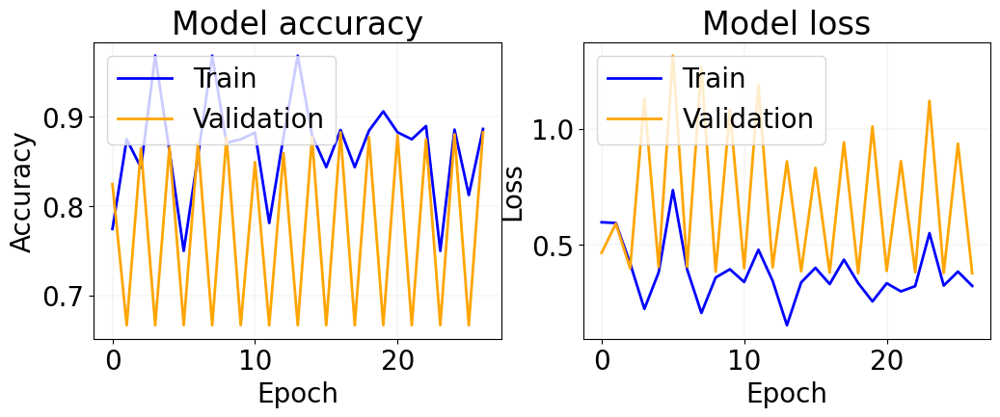

In [119]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet_fusion_model.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet_fusion_model.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet_fusion_model.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet_fusion_model.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()

#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 31s 1s/step - accuracy: 0.8884 - loss: 0.3035
Test Loss: 0.35161736607551575
Test Accuracy: 0.8802660703659058
29/29 ━━━━━━━━━━━━━━━━━━━━ 43s 1s/step
Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.91      0.89       305
           1       0.84      0.87      0.85       305
           2       0.95      0.85      0.90       292

    accuracy                           0.88       902
   macro avg       0.88      0.88      0.88       902
weighted avg       0.88      0.88      0.88       902



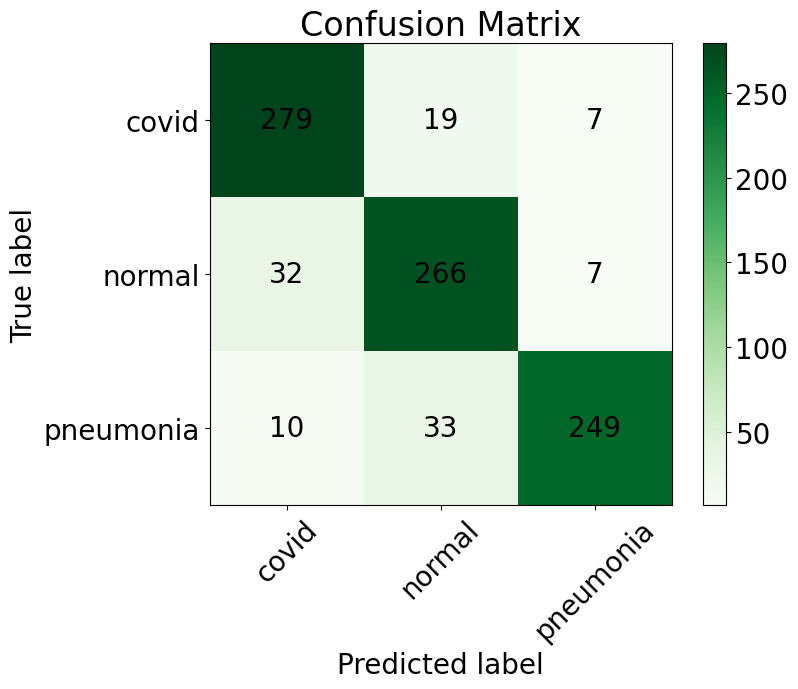

In [120]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet_fusion_model.evaluate(test_generator_fusion)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet_fusion_model.predict(test_generator_fusion), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_fusion.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_fusion.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_fusion.class_indices))
plt.xticks(tick_marks, test_generator_fusion.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_fusion.class_indices.keys())

for i in range(len(test_generator_fusion.class_indices)):
    for j in range(len(test_generator_fusion.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 31s 1s/step


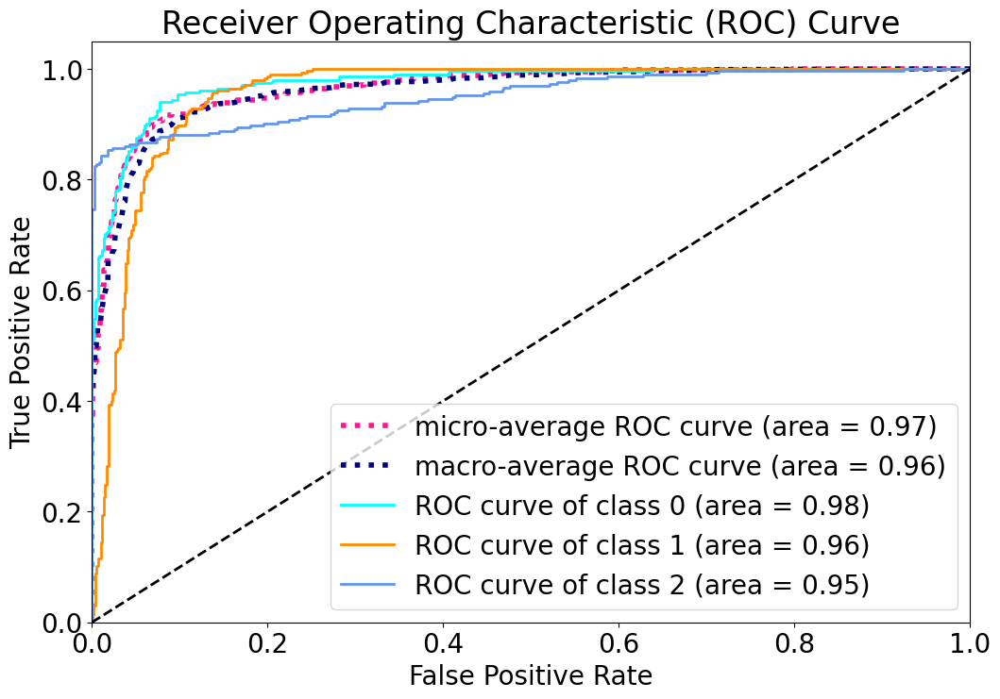

In [121]:
# Binarize the output
n_classes = len(test_generator_fusion.class_indices)
y_test = label_binarize(test_generator_fusion.classes, classes=[0, 1, 2])
y_score = densenet_fusion_model.predict(test_generator_fusion)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


### Summary of AG-DenseNet-121 Results

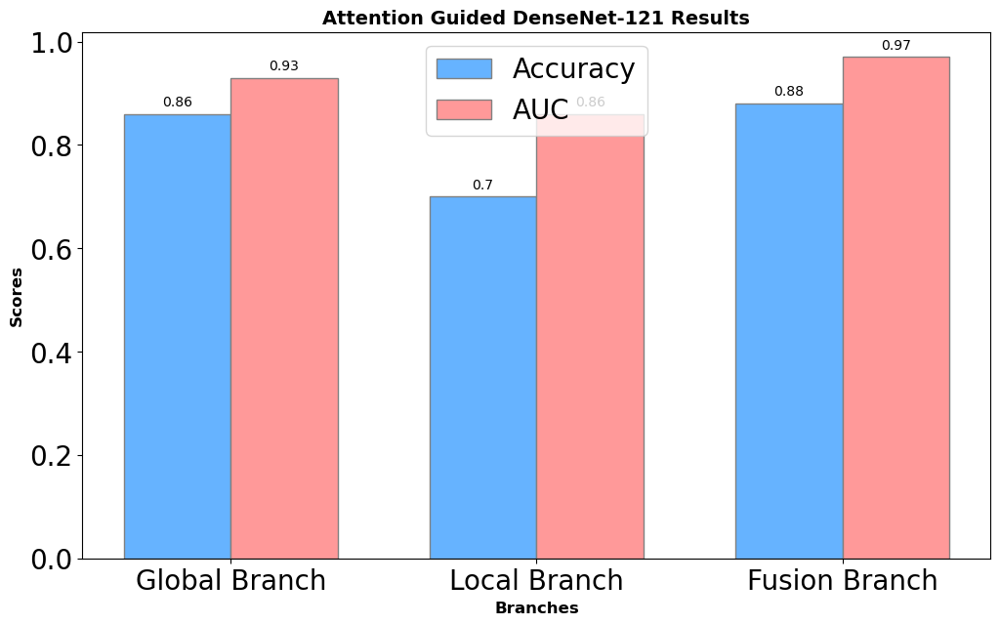

In [182]:
# Data
branches = ['Global Branch', 'Local Branch', 'Fusion Branch']
accuracies = [0.86, 0.70, 0.88]
aucs = [0.93, 0.86, 0.97]

# Bar width
bar_width = 0.35

# Positions of the bars on the x-axis
r1 = np.arange(len(branches))
r2 = [x + bar_width for x in r1]

# Colors
color_acc = '#66b3ff'
color_auc = '#ff9999'

# Create the plot
plt.figure(figsize=(12, 7))

# Bars for accuracies
bars1 = plt.bar(r1, accuracies, color=color_acc, width=bar_width, edgecolor='grey', label='Accuracy')

# Bars for AUCs
bars2 = plt.bar(r2, aucs, color=color_auc, width=bar_width, edgecolor='grey', label='AUC')

# Add labels on top of each bar
for bar in bars1:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom', fontsize=10)
for bar in bars2:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom', fontsize=10)

# Add labels
plt.xlabel('Branches', fontweight='bold', fontsize=12)
plt.ylabel('Scores', fontweight='bold', fontsize=12)
plt.title('Attention Guided DenseNet-121 Results', fontweight='bold', fontsize=14)
plt.xticks([r + bar_width / 2 for r in range(len(branches))], branches)

# Add legend
plt.legend()

# Show plot
plt.show()

## Attention-Guided Fine_Tuned Densenet-121

In [134]:
from tensorflow.keras.applications import DenseNet121

In [135]:
def densenet_pt(input_shape, n_classes, filters=32):
    
    inputs = Input(shape=input_shape)
    
    x = Conv2D(filters=3, kernel_size=(3, 3), padding='same', activation='relu')(inputs)
    
    base_model = DenseNet121(include_top=False, weights='imagenet', input_shape=(128, 128, 3))
    
    x = base_model(x, training=True)
    
    x = GlobalAveragePooling2D()(x)
    
    # x = Dense(256, activation='relu')(x)  # Added dense layer with 256 units
    
    output = Dense(n_classes, activation='softmax')(x)
    
    model = Model(inputs=inputs, outputs=output)
    return model

In [136]:
input_shape = (128, 128, 1)  # Grayscale image input
n_classes = 3

densenet121_pt = densenet_pt(input_shape, n_classes)

densenet121_pt.compile(optimizer=optimizers.Adam(learning_rate=0.0001),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet121_pt.summary()

Model: "functional_19325"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_14 (InputLayer)     │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 128, 128, 3)    │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ densenet121 (Functional)        │ (None, 4, 4, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_8      │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,040,609 (26.86 MB)

 Trainable params: 6,956,961 (26.54 MB)

 Non-trainable params: 83,648 (326.75 KB)

####  Training The Global Branch

In [137]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-3,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

# Calculate steps per epoch
steps_per_epoch = train_generator.samples // train_generator.batch_size
validation_steps = val_generator.samples // val_generator.batch_size


start_time = time.time()

history_densenet121_pt = densenet121_pt.fit(train_generator,
                           validation_data=val_generator,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet121_pt_history.pkl', 'wb') as file:
    pickle.dump(history_densenet121_pt.history, file)

densenet121_pt.save('densenet121_pt.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 369s 3s/step - accuracy: 0.6609 - loss: 0.8556 - val_accuracy: 0.3371 - val_loss: 2.5301 - learning_rate: 1.0000e-04
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 4:13 3s/step - accuracy: 0.9062 - loss: 0.2433

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step - accuracy: 0.9062 - loss: 0.2433 - val_accuracy: 0.1579 - val_loss: 3.4734 - learning_rate: 1.0000e-04
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 287s 3s/step - accuracy: 0.8714 - loss: 0.3640 - val_accuracy: 0.3348 - val_loss: 1.8258 - learning_rate: 1.0000e-04
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.9062 - loss: 0.2307 - val_accuracy: 0.2632 - val_loss: 1.6244 - learning_rate: 1.0000e-04
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 285s 3s/step - accuracy: 0.9121 - loss: 0.2606 - val_accuracy: 0.3348 - val_loss: 1.3725 - learning_rate: 1.0000e-04
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.9375 - loss: 0.2765 - val_accuracy: 0.3158 - val_loss: 1.3728 - learning_rate: 1.0000e-04
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 286s 3s/step - accuracy: 0.9259 - loss: 0.2331 - val_accuracy: 0.5022 - val_loss: 1.1463 - learning_rate: 1.0000e-04
Epoch 8/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.9375 - loss:

#### Validation Accuracy v.s. Training Accuracy

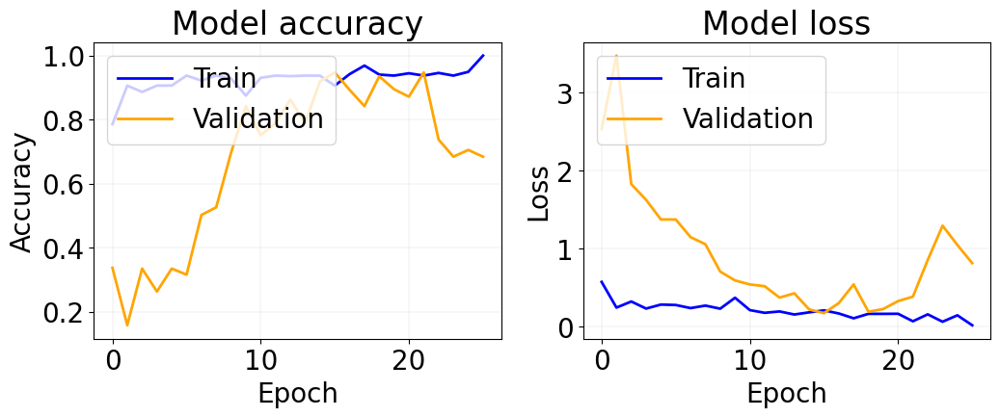

In [138]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet121_pt.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_pt.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet121_pt.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_pt.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()


#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 711ms/step - accuracy: 0.9293 - loss: 0.2020
Test Loss: 0.2313346415758133
Test Accuracy: 0.9202185869216919
29/29 ━━━━━━━━━━━━━━━━━━━━ 27s 806ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.93      0.94       305
           1       0.84      0.96      0.90       305
           2       0.98      0.88      0.93       305

    accuracy                           0.92       915
   macro avg       0.93      0.92      0.92       915
weighted avg       0.93      0.92      0.92       915



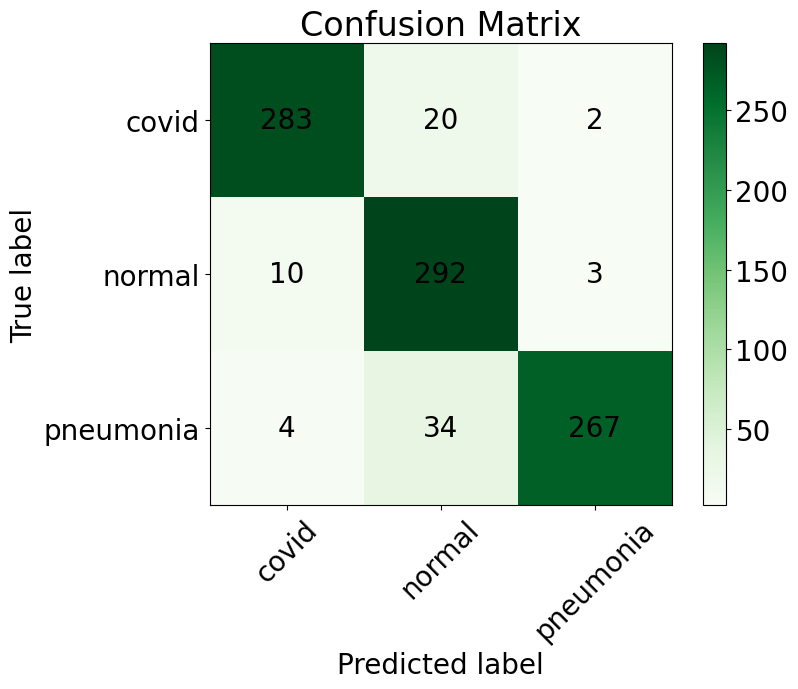

In [139]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet121_pt.evaluate(test_generator)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet121_pt.predict(test_generator), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator.class_indices))
plt.xticks(tick_marks, test_generator.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator.class_indices.keys())

for i in range(len(test_generator.class_indices)):
    for j in range(len(test_generator.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


29/29 ━━━━━━━━━━━━━━━━━━━━ 20s 690ms/step


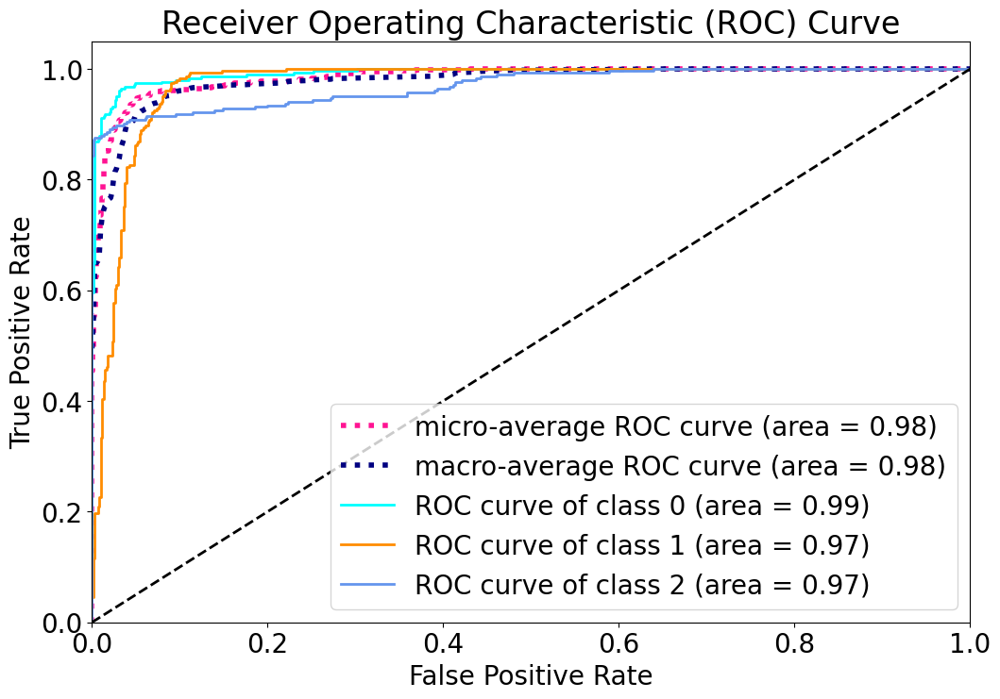

In [140]:
# Binarize the output
n_classes = len(test_generator.class_indices)
y_test = label_binarize(test_generator.classes, classes=[0, 1, 2])
y_score = densenet121_pt.predict(test_generator)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


In [141]:
global_model = load_model('densenet121_pt.keras')

### Mask Inference with DenseNet-121

In [145]:
def preprocess_input(images):
    # Convert numpy array to tensor
    images = tf.convert_to_tensor(images, dtype=tf.float32)
    return images

def get_heatmap(images, model, last_conv_layer_name, pred_index=None):
    densenet_model = model.get_layer('densenet121')
    last_conv_layer = densenet_model.get_layer(last_conv_layer_name)
    last_conv_layer_model = tf.keras.Model(inputs=densenet_model.input, outputs=last_conv_layer.output)
    conv_output = last_conv_layer_model(images, training=False)
    heatmap = tf.reduce_max(tf.abs(conv_output), axis=-1)
    heatmap = tf.maximum(heatmap, 0)
    heatmap /= (np.max(heatmap) + 1e-7)
    return heatmap

def attention_guided_mask_inference_batch(generator, model, last_conv_layer_name='relu'):
    masks = []
    images, _ = next(generator)
    images = preprocess_input(images)  # Ensure images are normalized
    for img in images:
        img = tf.expand_dims(img, axis=0)
        img = tf.image.grayscale_to_rgb(img)  # Convert grayscale to RGB for DenseNet
        heatmap = get_heatmap(img, model, last_conv_layer_name)
        if heatmap is None:
            continue
        threshold = 0.7
        mask = heatmap > threshold
        masks.append(tf.cast(mask, tf.float32))
    masks = tf.convert_to_tensor(masks, dtype=tf.float32)
    masks = tf.expand_dims(masks, axis=-1)
    return masks, images

def crop_local_region_batch(images, masks, input_shape=(128, 128)):
    cropped_images = []
    for i in range(images.shape[0]):
        if i >= len(masks):
            continue
        mask = masks[i].numpy().astype(np.uint8)
        if mask.size == 0:
            continue
        mask = np.squeeze(mask)
        mask = cv2.resize(mask, (input_shape[1], input_shape[0]))
        image = images[i]
        if isinstance(image, tf.Tensor):
            image = image.numpy()
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if len(contours) == 0:
            cropped_image = cv2.resize(image, (input_shape[1], input_shape[0]))
            cropped_images.append(cropped_image)
            continue
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)
        cropped_image = image[y:y+h, x:x+w]
        cropped_image = cv2.resize(cropped_image, (input_shape[1], input_shape[0]))
        cropped_images.append(cropped_image)
    cropped_images = np.array(cropped_images)
    return tf.convert_to_tensor(cropped_images, dtype=tf.float32)

def save_cropped_images_to_directory(generator, model, output_dir, subset, last_conv_layer_name='relu'):
    original_images_dir = os.path.join(output_dir, f'{subset}_original')
    cropped_images_dir = os.path.join(output_dir, f'{subset}_cropped')
    classes = ["covid", "normal", "pneumonia"]
    os.makedirs(original_images_dir, exist_ok=True)
    os.makedirs(cropped_images_dir, exist_ok=True)
    generator.reset()
    total_samples = 0
    while total_samples < generator.samples:
        images, labels = next(generator)
        images = preprocess_input(images)  # Ensure images are normalized
        masks, _ = attention_guided_mask_inference_batch(generator, model, last_conv_layer_name)
        cropped_images = crop_local_region_batch(images, masks)
        for i, (original_img, cropped_img, label) in enumerate(zip(images, cropped_images, labels)):
            class_name = classes[int(label)]
            orig_class_dir = os.path.join(original_images_dir, class_name)
            crop_class_dir = os.path.join(cropped_images_dir, class_name)
            os.makedirs(orig_class_dir, exist_ok=True)
            os.makedirs(crop_class_dir, exist_ok=True)
            orig_img_path = os.path.join(orig_class_dir, f"{total_samples + i}.png")
            crop_img_path = os.path.join(crop_class_dir, f"{total_samples + i}.png")
            original_img = (original_img.numpy() * 255).astype(np.uint8)
            cropped_img = (cropped_img.numpy() * 255).astype(np.uint8)
            cv2.imwrite(orig_img_path, original_img.squeeze())
            cv2.imwrite(crop_img_path, cropped_img.squeeze())
        total_samples += len(images)

def plot_samples_with_masks_and_crops(generator, model, num_samples=5, last_conv_layer_name='relu'):
    classes = ["covid", "normal", "pneumonia"]
    batch_images, batch_labels = next(generator)
    num_samples = min(num_samples, len(batch_images))
    batch_images = preprocess_input(batch_images)  # Ensure images are normalized
    masks, _ = attention_guided_mask_inference_batch(generator, model, last_conv_layer_name)
    cropped_images = crop_local_region_batch(batch_images, masks)
    predictions = model.predict(batch_images)
    predicted_labels = np.argmax(predictions, axis=1)
    plt.figure(figsize=(20, num_samples * 5))
    for i in range(num_samples):
        original_img = batch_images[i].numpy().squeeze()
        mask = masks[i].numpy().squeeze()
        cropped_img = cropped_images[i].numpy().squeeze()
        true_label = classes[int(batch_labels[i])]
        predicted_label = classes[int(predicted_labels[i])]
        
        heatmap = cv2.resize(mask, (original_img.shape[1], original_img.shape[0]))
        heatmap = np.uint8(255 * heatmap)
        heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        alpha = 0.3
        if original_img.ndim == 2:
            original_img = cv2.cvtColor((original_img * 255).astype('uint8'), cv2.COLOR_GRAY2RGB)
        superimposed_img = cv2.addWeighted(original_img, 1 - alpha, heatmap_colored, alpha, 0)
        
        plt.subplot(num_samples, 4, i * 4 + 1)
        plt.imshow(original_img, cmap='gray')
        plt.title(f"Original: {true_label}")
        plt.axis('off')
        
        plt.subplot(num_samples, 4, i * 4 + 2)
        plt.imshow(heatmap_colored)
        plt.title(f"Mask: {true_label}")
        plt.axis('off')
        
        plt.subplot(num_samples, 4, i * 4 + 3)
        plt.imshow(superimposed_img)
        plt.title('Mask Overlayed')
        plt.axis('off')
        
        plt.subplot(num_samples, 4, i * 4 + 4)
        plt.imshow(cropped_img, cmap='gray')
        plt.title(f"True Label: {true_label}\nPredicted Label: {predicted_label}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

#### Some Samples from  The Generated Masks and Cropped Images

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 781ms/step


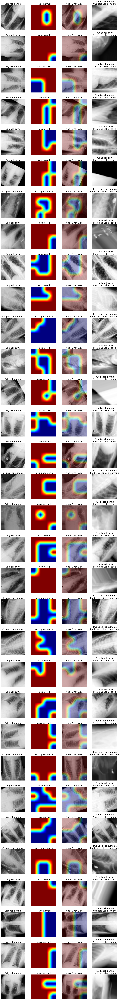

In [146]:
# Example of plotting using the train_generator and global_model
plot_samples_with_masks_and_crops(train_generator, global_model, num_samples=32, last_conv_layer_name='relu')

#### Saving The Cropped Images

In [147]:
# Now you can use this function with the data generators
save_cropped_images_to_directory(train_generator, global_model, output_dir, 'train')
save_cropped_images_to_directory(val_generator, global_model, output_dir, 'validation')
save_cropped_images_to_directory(test_generator, global_model, output_dir, 'test')

print(f"Original and cropped images have been organized and saved to {output_dir}")

Original and cropped images have been organized and saved to ./organized_data/


### Create The Local Dataset with DenseNet-121

In [148]:
# output_dir = '/content/drive/MyDrive/HDA/organized_data/'
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_dir = os.path.join(output_dir, 'train_cropped')
val_dir = os.path.join(output_dir, 'validation_cropped')
test_dir = os.path.join(output_dir, 'test_cropped')

datagen_train_local = ImageDataGenerator(rescale=1./255)

datagen_val_local = ImageDataGenerator(rescale=1./255)

# Create generators for training and validation data
train_generator_local = datagen_train_local.flow_from_directory(
    directory=train_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

val_generator_local = datagen_val_local.flow_from_directory(
    directory=val_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=True
)

test_generator_local = datagen_val_local.flow_from_directory(
    directory=test_dir,
    target_size=(128, 128),
    batch_size=32,
    color_mode='grayscale',
    class_mode='sparse',
    shuffle=False
)


Found 2738 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.


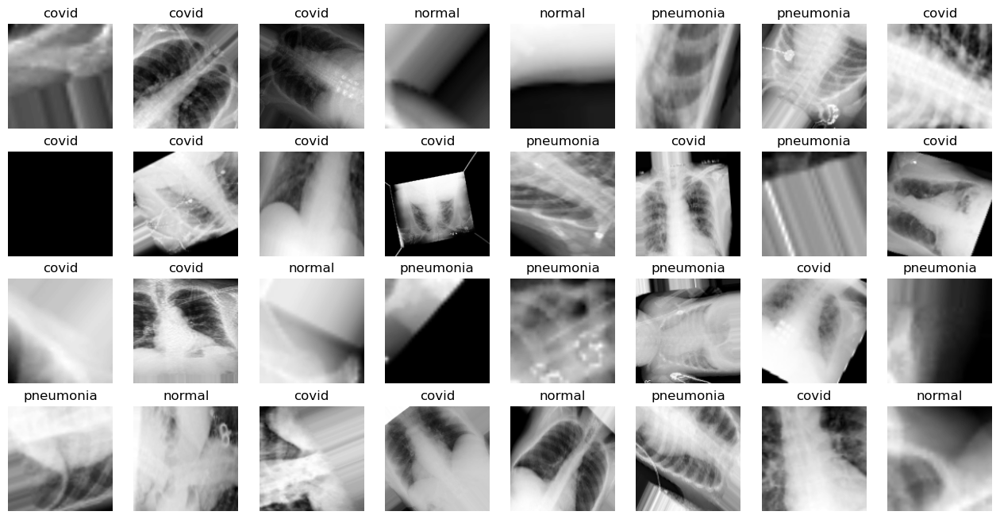

In [149]:
classes = ["covid", "normal", "pneumonia"]
plt.rcParams.update({'font.size': 10})

# Get a batch of images and labels from the validation generator
batch_images, batch_labels = next(train_generator_local)

# Function to plot images
def plot_images(images, labels, class_names, n_cols=8):
    n_rows = len(images) // n_cols + (len(images) % n_cols != 0)
    plt.figure(figsize=(16, 2 * n_rows))
    for i in range(len(images)):
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(images[i],cmap='gray')
        plt.title(class_names[int(labels[i])])
        plt.axis('off')

    plt.show()

# Plot some images from the validation set
plot_images(batch_images, batch_labels, classes)


### Local Branch with DenseNet-121

In [150]:
input_shape = (128, 128, 1)  # Grayscale image input
n_classes = 3
densenet121_pt_local = densenet_pt(input_shape, n_classes)

densenet121_pt_local.compile(optimizer=optimizers.Adam(learning_rate=0.001),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet121_pt_local.summary()

Model: "functional_28591"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_17 (InputLayer)     │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 128, 128, 3)    │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ densenet121 (Functional)        │ (None, 4, 4, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_9      │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,040,609 (26.86 MB)

 Trainable params: 6,956,961 (26.54 MB)

 Non-trainable params: 83,648 (326.75 KB)

#### Training The Local Branch

In [151]:
# Define callbacks
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # Set logging level to suppress warnings
logging.getLogger('tensorflow').setLevel(logging.ERROR)

early_stopping = EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-2,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

# Calculate steps per epoch
steps_per_epoch = train_generator_local.samples // train_generator_local.batch_size
validation_steps = val_generator_local.samples // val_generator_local.batch_size


start_time = time.time()

history_densenet121_pt_local = densenet121_pt_local.fit(train_generator_local,
                           validation_data=val_generator_local,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet121_pt_history_local.pkl', 'wb') as file:
    pickle.dump(history_densenet121_pt_local.history, file)

densenet121_pt_local.save('densenet121_pt_local.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100


C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


85/85 ━━━━━━━━━━━━━━━━━━━━ 367s 4s/step - accuracy: 0.5119 - loss: 1.1947 - val_accuracy: 0.3538 - val_loss: 1.4282 - learning_rate: 0.0010
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 4:15 3s/step - accuracy: 0.6875 - loss: 0.6447

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.6875 - loss: 0.6447 - val_accuracy: 0.5000 - val_loss: 0.8913 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 288s 3s/step - accuracy: 0.6579 - loss: 0.8031 - val_accuracy: 0.5614 - val_loss: 1.0558 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.5625 - loss: 1.2513 - val_accuracy: 0.3333 - val_loss: 1.0969 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 286s 3s/step - accuracy: 0.7028 - loss: 0.7316 - val_accuracy: 0.4074 - val_loss: 4.5251 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.5000 - loss: 1.1046 - val_accuracy: 0.6667 - val_loss: 1.0274 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6912 - loss: 0.7514
Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
85/85 ━━━━━━━━━━━━━━━━━━━━ 294s 3s/step - accuracy: 0.6909 - loss: 0.7517 - val_accuracy: 0.51

#### Validation v.s. Training Accuracy

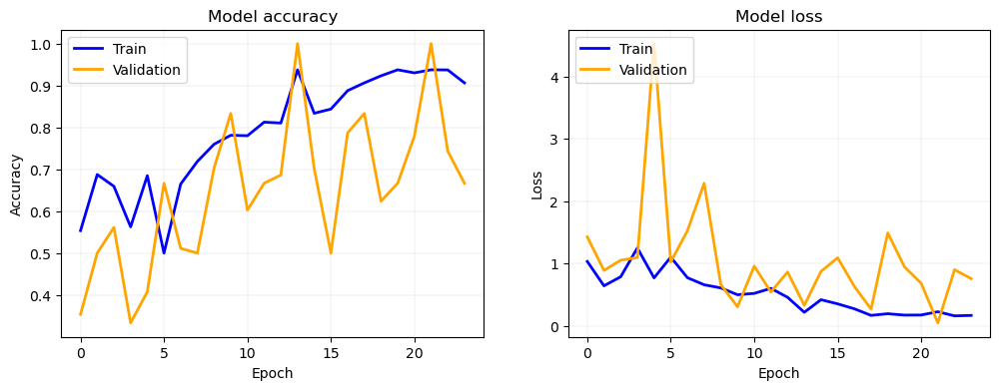

In [152]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet121_pt_local.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_pt_local.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet121_pt_local.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet121_pt_local.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()

#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 4626s 165s/step - accuracy: 0.7347 - loss: 0.7057
Test Loss: 0.6906136870384216
Test Accuracy: 0.7294900417327881
29/29 ━━━━━━━━━━━━━━━━━━━━ 31s 885ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.74      0.78      0.76       305
           1       0.73      0.65      0.69       305
           2       0.71      0.76      0.74       292

    accuracy                           0.73       902
   macro avg       0.73      0.73      0.73       902
weighted avg       0.73      0.73      0.73       902



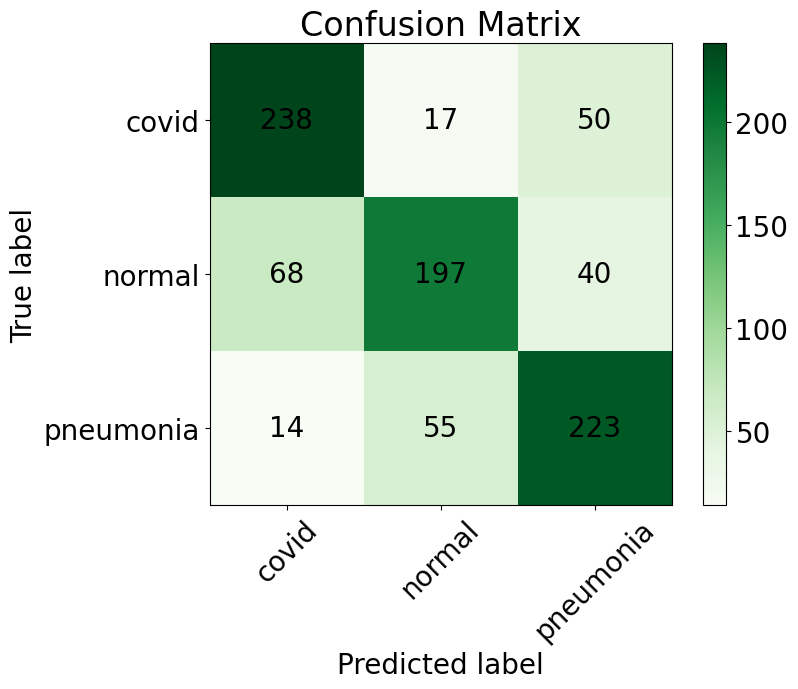

In [153]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet121_pt_local.evaluate(test_generator_local)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet121_pt_local.predict(test_generator_local), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_local.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_local.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_local.class_indices))
plt.xticks(tick_marks, test_generator_local.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_local.class_indices.keys())

for i in range(len(test_generator_local.class_indices)):
    for j in range(len(test_generator_local.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 726ms/step


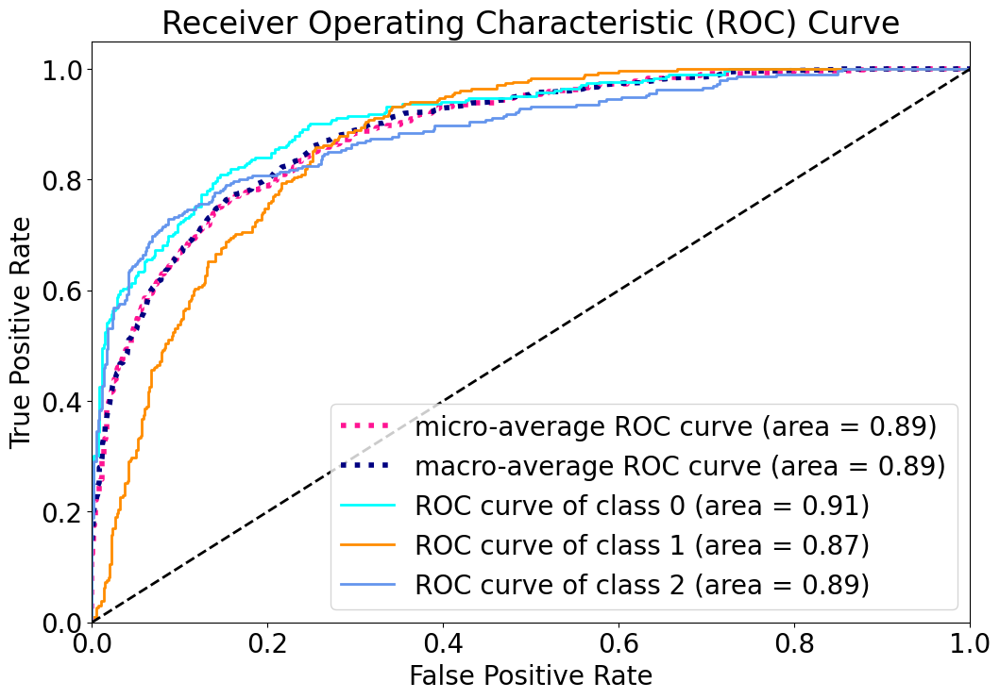

In [154]:
# Binarize the output
n_classes = len(test_generator_local.class_indices)
y_test = label_binarize(test_generator_local.classes, classes=[0, 1, 2])
y_score = densenet121_pt_local.predict(test_generator_local)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


### Create Fusion Dataset

In [155]:
class DualImageDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, global_dir, local_dir, batch_size, target_size=(128, 128), color_mode='grayscale', class_mode='sparse'):
        self.global_dir = global_dir
        self.local_dir = local_dir
        self.batch_size = batch_size
        self.target_size = target_size
        self.color_mode = color_mode
        self.class_mode = class_mode
        self.global_datagen = ImageDataGenerator(rescale=1./255)
        self.local_datagen = ImageDataGenerator(rescale=1./255)

        self.global_generator = self.global_datagen.flow_from_directory(
            directory=self.global_dir,
            target_size=self.target_size,
            batch_size=self.batch_size,
            color_mode=self.color_mode,
            class_mode=self.class_mode,
            shuffle=False
        )

        self.local_generator = self.local_datagen.flow_from_directory(
            directory=self.local_dir,
            target_size=self.target_size,
            batch_size=self.batch_size,
            color_mode=self.color_mode,
            class_mode=self.class_mode,
            shuffle=False
        )
        
        self.classes = self.global_generator.classes

    def __len__(self):
        return len(self.global_generator)

    def __getitem__(self, index):
        global_images, labels = self.global_generator[index]
        local_images, _ = self.local_generator[index]
        return (global_images, local_images), labels

    def on_epoch_end(self):
        pass  # No need to shuffle, so we can remove the shuffling logic

    @property
    def class_indices(self):
        return self.global_generator.class_indices

In [156]:
# output_dir = '/content/drive/MyDrive/HDA/organized_data/'
output_dir = './organized_data/'

# Specify the paths to the training and validation directories
train_global_dir = os.path.join(output_dir, 'train_original')
train_local_dir = os.path.join(output_dir, 'train_cropped')
val_global_dir = os.path.join(output_dir, 'validation_original')
val_local_dir = os.path.join(output_dir, 'validation_cropped')
test_global_dir = os.path.join(output_dir, 'test_original')
test_local_dir = os.path.join(output_dir, 'test_cropped')

In [157]:
# Create custom data generators for training and validation data
train_generator_fusion = DualImageDataGenerator(train_global_dir, train_local_dir, batch_size=32)
val_generator_fusion = DualImageDataGenerator(val_global_dir, val_local_dir, batch_size=32)
test_generator_fusion = DualImageDataGenerator(test_global_dir, test_local_dir, batch_size=32)

Found 2738 images belonging to 3 classes.
Found 2738 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.
Found 902 images belonging to 3 classes.


#### Plot Some Samples

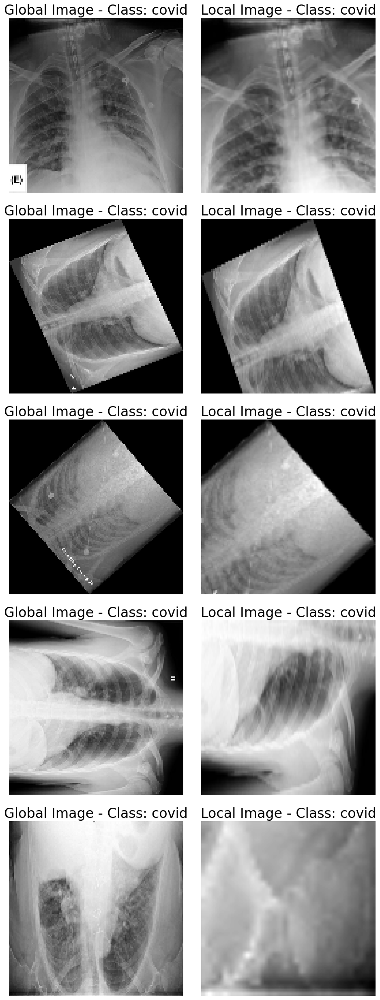

In [158]:
def plot_samples_from_dual_generator(generator, num_samples=5):
    """
    Plot samples from the DualImageDataGenerator to ensure global and local images belong to each other.

    :param generator: Instance of DualImageDataGenerator.
    :param num_samples: Number of samples to plot.
    """
    classes = list(generator.global_generator.class_indices.keys())
    total_samples_plotted = 0
    batch_index = 0
    
    plt.figure(figsize=(10, num_samples * 5))
    
    while total_samples_plotted < num_samples:
        (global_images, local_images), labels = generator[batch_index]
        batch_index += 1

        for j in range(len(global_images)):
            if total_samples_plotted >= num_samples:
                break
                
            global_img = global_images[j].squeeze()
            local_img = local_images[j].squeeze()
            label = classes[int(labels[j])]

            plt.subplot(num_samples, 2, total_samples_plotted * 2 + 1)
            plt.imshow(global_img, cmap='gray')
            plt.title(f"Global Image - Class: {label}")
            plt.axis('off')

            plt.subplot(num_samples, 2, total_samples_plotted * 2 + 2)
            plt.imshow(local_img, cmap='gray')
            plt.title(f"Local Image - Class: {label}")
            plt.axis('off')

            total_samples_plotted += 1
    
    plt.tight_layout()
    plt.show()

# Example usage of the plot function
plot_samples_from_dual_generator(test_generator_fusion, num_samples=5)


### Fusion Branch

In [159]:
# Load the pre-trained global and local models
global_branch = load_model('densenet121_pt.keras')
local_branch = load_model('densenet121_pt_local.keras')

#### Rename The Layers

In [160]:
# Function to rename the layers of a model
def rename_model_layers(model, prefix):
    config = model.get_config()
    for layer in config['layers']:
        layer['config']['name'] = prefix + layer['config']['name']
    new_model = Model.from_config(config)
    new_model.set_weights(model.get_weights())
    return new_model
# Rename the layers of the global and local models
global_branch = rename_model_layers(global_branch, 'global_')
local_branch = rename_model_layers(local_branch, 'local_')


In [161]:
global_branch.summary()

Model: "functional_19325"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ global_input_layer_14           │ (None, 128, 128, 1)    │             0 │
│ (InputLayer)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_conv2d_25 (Conv2D)       │ (None, 128, 128, 3)    │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_densenet121 (Functional) │ (None, 4, 4, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_global_average_pooling2… │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_dense_17 (Dense)         │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,040,609 (26.86 MB)

 Trainable params: 6,956,961 (26.54 MB)

 Non-trainable params: 83,648 (326.75 KB)

In [162]:
local_branch.summary()

Model: "functional_28591"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ local_input_layer_17            │ (None, 128, 128, 1)    │             0 │
│ (InputLayer)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_conv2d_26 (Conv2D)        │ (None, 128, 128, 3)    │            30 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_densenet121 (Functional)  │ (None, 4, 4, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_global_average_pooling2d… │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ local_dense_18 (Dense)          │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,040,609 (26.86 MB)

 Trainable params: 6,956,961 (26.54 MB)

 Non-trainable params: 83,648 (326.75 KB)

#### Freeze The Global & Local Branch

In [163]:
# Freeze the layers in the global and local models
for layer in global_branch.layers:
    layer.trainable = False

for layer in local_branch.layers:
    layer.trainable = False

In [168]:
# Create the fusion model

def create_fusion_model(global_model, local_model):

    # Take the outputs of the last pooling layers
    global_output = global_model.get_layer('global_global_average_pooling2d_8').output
    local_output = local_model.get_layer('local_global_average_pooling2d_9').output

    # Concatenate the outputs of the global and local branches
    combined_input = layers.concatenate([global_output, local_output])

    # Add a fully connected layer and the final output layer
    #x = layers.Dense(512, activation='relu')(combined_input)
    #x = layers.Dense(64, activation='relu')
    x = layers.Dense(3, activation='softmax')(combined_input)

    model = models.Model(inputs=[global_model.input, local_model.input], outputs=x)
    return model


densenet_pt_fusion_model = create_fusion_model(global_branch, local_branch)
densenet_pt_fusion_model.compile(optimizer=optimizers.Adam(1e-3),
                     loss=losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

densenet_pt_fusion_model.summary()

Model: "functional_28595"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ global_input_layer… │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_input_layer_… │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_conv2d_25    │ (None, 128, 128,  │         30 │ global_input_lay… │
│ (Conv2D)            │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_conv2d_26     │ (None, 128, 128,  │         30 │ local_input_laye… │
│ (Conv2D)            │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_densenet121  │ (None, 4, 4,      │  7,037,504 │ global_conv2d_25… │
│ (Functional)        │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_densenet121   │ (None, 4, 4,      │  7,037,504 │ local_conv2d_26[… │
│ (Functional)        │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_global_aver… │ (None, 1024)      │          0 │ global_densenet1… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ local_global_avera… │ (None, 1024)      │          0 │ local_densenet12… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_7       │ (None, 2048)      │          0 │ global_global_av… │
│ (Concatenate)       │                   │            │ local_global_ave… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_22 (Dense)    │ (None, 3)         │      6,147 │ concatenate_7[0]… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 14,081,215 (53.72 MB)

 Trainable params: 6,147 (24.01 KB)

 Non-trainable params: 14,075,068 (53.69 MB)

#### Traing The Fusion Branch 

In [169]:
# Define callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',  # 'val_accuracy' or 'val_loss', depending on your setup
    min_delta=1e-3,
    patience=10,
    verbose=1,
    mode='max',  # 'max' if you're monitoring accuracy, 'min' for loss
    restore_best_weights=True
)

rlronp = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    verbose=1,
    mode='auto'
)

steps_per_epoch = 2738 // 32
validation_steps = 902 // 32

start_time = time.time()

history_densenet_pt_fusion_model = densenet_pt_fusion_model.fit(train_generator_fusion,
                           validation_data=val_generator_fusion,
                           epochs=100,
                           verbose=1,
                           steps_per_epoch=steps_per_epoch,
                           validation_steps=validation_steps,
                           callbacks=[early_stopping, rlronp])

end_time = time.time()
elapsed_time = end_time - start_time

with open('densenet_pt_fusion_model_history.pkl', 'wb') as file:
    pickle.dump(history_densenet_pt_fusion_model.history, file)

densenet_pt_fusion_model.save('densenet_pt_fusion_model.keras')

print(f"Training took {elapsed_time} seconds.")


Epoch 1/100


C:\Users\PoD\AppData\Roaming\Python\Python39\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


85/85 ━━━━━━━━━━━━━━━━━━━━ 207s 2s/step - accuracy: 0.6183 - loss: 1.3245 - val_accuracy: 0.9018 - val_loss: 0.3598 - learning_rate: 0.0010
Epoch 2/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 1:53 1s/step - accuracy: 0.7188 - loss: 0.5616

C:\ProgramData\Anaconda3\lib\contextlib.py:137: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.7188 - loss: 0.5616 - val_accuracy: 0.5000 - val_loss: 1.2955 - learning_rate: 0.0010
Epoch 3/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 157s 2s/step - accuracy: 0.8866 - loss: 0.3396 - val_accuracy: 0.9152 - val_loss: 0.2814 - learning_rate: 0.0010
Epoch 4/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.9062 - loss: 0.2566 - val_accuracy: 0.5000 - val_loss: 1.8335 - learning_rate: 0.0010
Epoch 5/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 167s 2s/step - accuracy: 0.9005 - loss: 0.3369 - val_accuracy: 0.8538 - val_loss: 0.4585 - learning_rate: 0.0010
Epoch 6/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 1.0000 - loss: 0.1411 - val_accuracy: 0.5000 - val_loss: 1.6863 - learning_rate: 0.0010
Epoch 7/100
85/85 ━━━━━━━━━━━━━━━━━━━━ 163s 2s/step - accuracy: 0.9041 - loss: 0.3092 - val_accuracy: 0.8650 - val_loss: 0.4298 - learning_rate: 0.0010
Epoch 8/100
 1/85 ━━━━━━━━━━━━━━━━━━━━ 1:59 1s/step - accuracy: 0.9062 - loss: 0.2022
Epoch 8: ReduceL

#### Validation Accuracy v.s. Training Accuracy

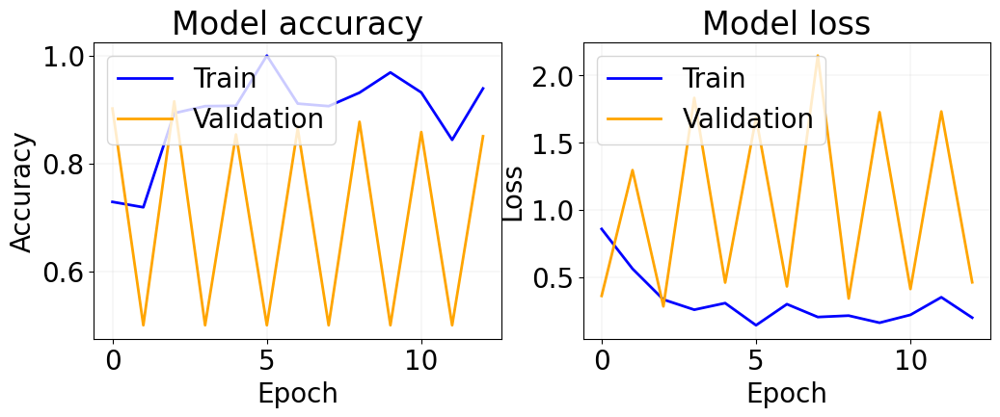

In [170]:
# Plot loss and accuracy
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_densenet_pt_fusion_model.history['accuracy'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet_pt_fusion_model.history['val_accuracy'], color='orange', linewidth=2, label='Validation')
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_densenet_pt_fusion_model.history['loss'], color='blue', linewidth=2, label='Train')
plt.plot(history_densenet_pt_fusion_model.history['val_loss'], color='orange', linewidth=2, label='Validation')
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.grid(color='lightgray', linestyle='-', linewidth=0.25)

plt.show()

#### Test Accuracy & Confusion Matrix

29/29 ━━━━━━━━━━━━━━━━━━━━ 40s 1s/step - accuracy: 0.9314 - loss: 0.2166
Test Loss: 0.2843482196331024
Test Accuracy: 0.9124168753623962
29/29 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step
Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.95      0.94       305
           1       0.84      0.94      0.89       305
           2       0.97      0.85      0.91       292

    accuracy                           0.91       902
   macro avg       0.92      0.91      0.91       902
weighted avg       0.92      0.91      0.91       902



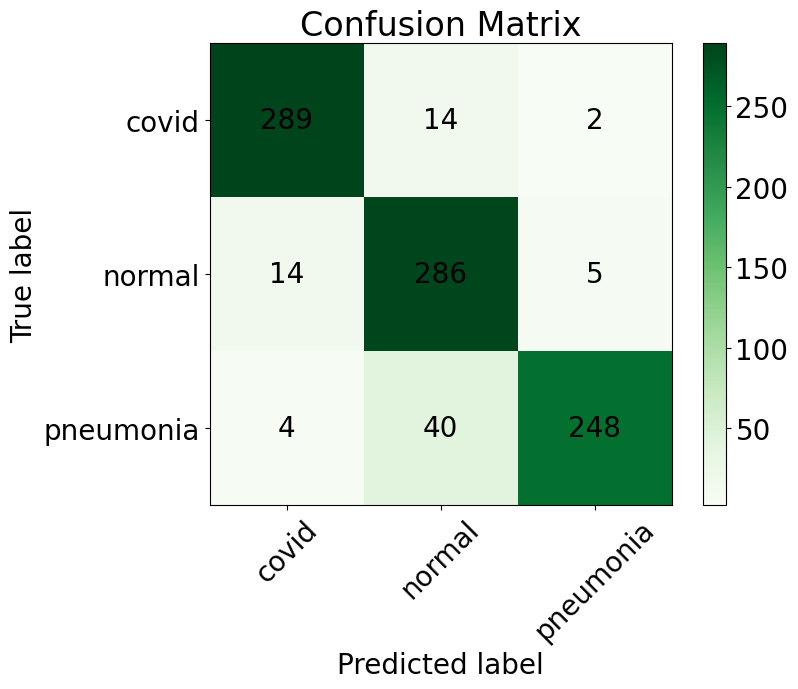

In [171]:
# Set font size for all elements
plt.rcParams.update({'font.size': 20})

# Evaluate the model on the test set using the test generator
evaluation = densenet_pt_fusion_model.evaluate(test_generator_fusion)

# Print evaluation metrics
print("Test Loss:", evaluation[0])
print("Test Accuracy:", evaluation[1])

# Generate predictions using the test generator
y_pred = np.argmax(densenet_pt_fusion_model.predict(test_generator_fusion), axis=1)

# Print classification report and confusion matrix
print("Classification Report:\n", classification_report(test_generator_fusion.classes, y_pred))

# Plot confusion matrix with values
plt.figure(figsize=(8, 6))
cm = confusion_matrix(test_generator_fusion.classes, y_pred)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(test_generator_fusion.class_indices))
plt.xticks(tick_marks, test_generator_fusion.class_indices.keys(), rotation=45)
plt.yticks(tick_marks, test_generator_fusion.class_indices.keys())

for i in range(len(test_generator_fusion.class_indices)):
    for j in range(len(test_generator_fusion.class_indices)):
        plt.text(j, i, str(cm[i, j]), ha='center', va='center', color='black')

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


#### ROC Curve

29/29 ━━━━━━━━━━━━━━━━━━━━ 40s 1s/step


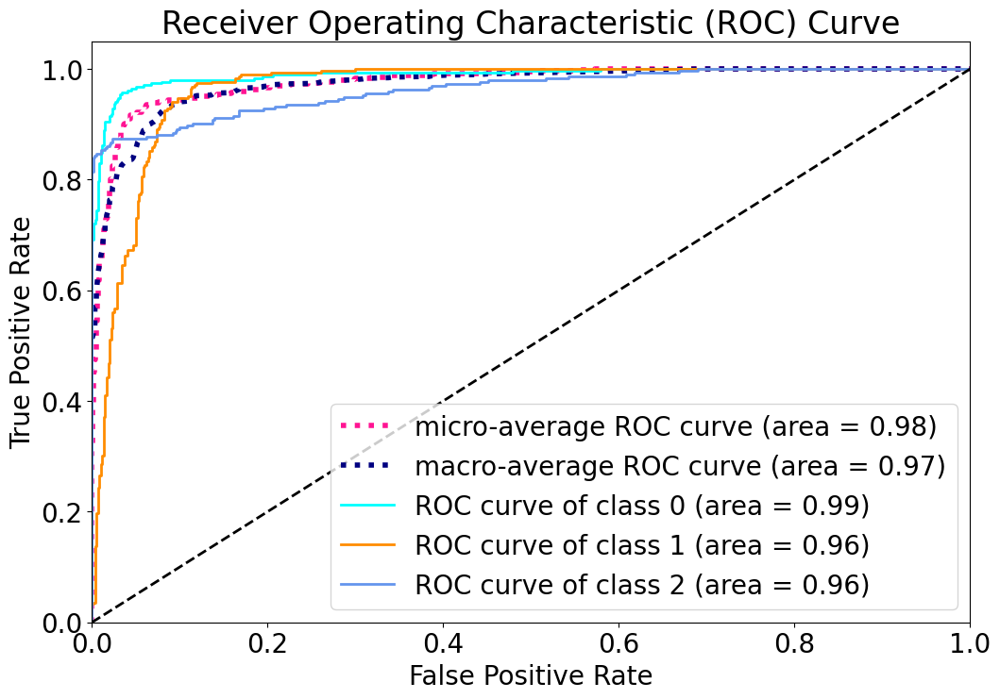

In [172]:
# Binarize the output
n_classes = len(test_generator_fusion.class_indices)
y_test = label_binarize(test_generator_fusion.classes, classes=[0, 1, 2])
y_score = densenet_pt_fusion_model.predict(test_generator_fusion)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(figsize=(12, 8))

plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


### Summary of AG- Fine_Tuned DenseNet-121 Results

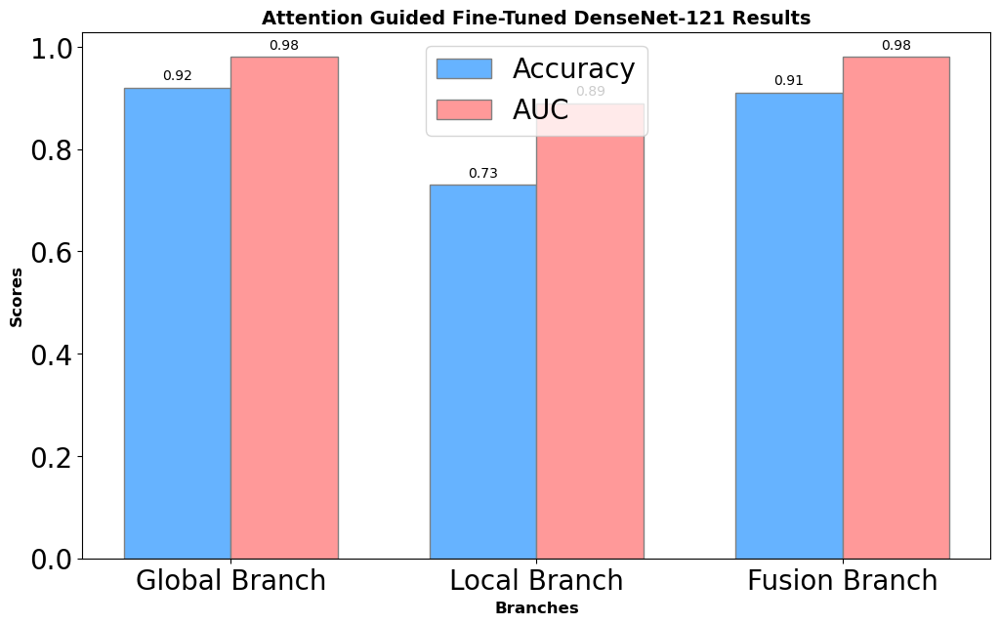

In [183]:
# Data
branches = ['Global Branch', 'Local Branch', 'Fusion Branch']
accuracies = [0.92, 0.73 , 0.91]
aucs = [0.98, 0.89, 0.98]

# Bar width
bar_width = 0.35

# Positions of the bars on the x-axis
r1 = np.arange(len(branches))
r2 = [x + bar_width for x in r1]

# Colors
color_acc = '#66b3ff'
color_auc = '#ff9999'

# Create the plot
plt.figure(figsize=(12, 7))

# Bars for accuracies
bars1 = plt.bar(r1, accuracies, color=color_acc, width=bar_width, edgecolor='grey', label='Accuracy')

# Bars for AUCs
bars2 = plt.bar(r2, aucs, color=color_auc, width=bar_width, edgecolor='grey', label='AUC')

# Add labels on top of each bar
for bar in bars1:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom', fontsize=10)
for bar in bars2:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom', fontsize=10)

# Add labels
plt.xlabel('Branches', fontweight='bold', fontsize=12)
plt.ylabel('Scores', fontweight='bold', fontsize=12)
plt.title('Attention Guided Fine-Tuned DenseNet-121 Results', fontweight='bold', fontsize=14)
plt.xticks([r + bar_width / 2 for r in range(len(branches))], branches)

# Add legend
plt.legend()

# Show plot
plt.show()

## Comparison of The Models

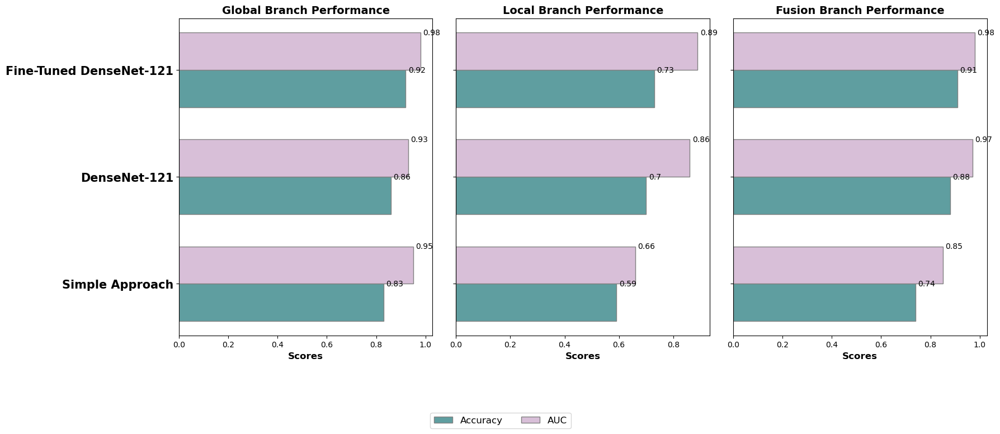

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# Data
models = ['Simple Approach', 'DenseNet-121', 'Fine-Tuned DenseNet-121']
branches = ['Global Branch', 'Local Branch', 'Fusion Branch']

# Performance metrics
global_acc = [0.83, 0.86, 0.92]
global_auc = [0.95, 0.93, 0.98]
local_acc = [0.59, 0.70, 0.73]
local_auc = [0.66, 0.86, 0.89]
fusion_acc = [0.74, 0.88, 0.91]
fusion_auc = [0.85, 0.97, 0.98]

# Bar width
bar_width = 0.35

# Positions of the bars on the y-axis
r1 = np.arange(len(models))
r2 = [x + bar_width for x in r1]

# Colors
color_acc = 'cadetblue'
color_auc = 'thistle'

# Create a single figure with multiple subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 7))

# Create the plot for Global Branch
bars1 = axs[0].barh(r1, global_acc, color=color_acc, height=bar_width, edgecolor='grey', label='Accuracy')
bars2 = axs[0].barh(r2, global_auc, color=color_auc, height=bar_width, edgecolor='grey', label='AUC')
for i in range(len(global_acc)):
    axs[0].text(global_acc[i] + 0.01, r1[i] + bar_width/2, round(global_acc[i], 2), va='center', ha='left', fontsize=10)
    axs[0].text(global_auc[i] + 0.01, r2[i] + bar_width/2, round(global_auc[i], 2), va='center', ha='left', fontsize=10)
axs[0].set_yticks([r + bar_width / 2 for r in range(len(models))])
axs[0].set_yticklabels(models, fontsize=15, fontweight='bold')
axs[0].set_xlabel('Scores', fontweight='bold', fontsize=12)
axs[0].set_title('Global Branch Performance', fontweight='bold', fontsize=14)

# Create the plot for Local Branch
bars1 = axs[1].barh(r1, local_acc, color=color_acc, height=bar_width, edgecolor='grey', label='Accuracy')
bars2 = axs[1].barh(r2, local_auc, color=color_auc, height=bar_width, edgecolor='grey', label='AUC')
for i in range(len(local_acc)):
    axs[1].text(local_acc[i] + 0.01, r1[i] + bar_width/2, round(local_acc[i], 2), va='center', ha='left', fontsize=10)
    axs[1].text(local_auc[i] + 0.01, r2[i] + bar_width/2, round(local_auc[i], 2), va='center', ha='left', fontsize=10)
axs[1].set_yticks([r + bar_width / 2 for r in range(len(models))])
axs[1].set_yticklabels([''] * len(models))  # No y-axis labels
axs[1].set_xlabel('Scores', fontweight='bold', fontsize=12)
axs[1].set_title('Local Branch Performance', fontweight='bold', fontsize=14)

# Create the plot for Fusion Branch
bars1 = axs[2].barh(r1, fusion_acc, color=color_acc, height=bar_width, edgecolor='grey', label='Accuracy')
bars2 = axs[2].barh(r2, fusion_auc, color=color_auc, height=bar_width, edgecolor='grey', label='AUC')
for i in range(len(fusion_acc)):
    axs[2].text(fusion_acc[i] + 0.01, r1[i] + bar_width/2, round(fusion_acc[i], 2), va='center', ha='left', fontsize=10)
    axs[2].text(fusion_auc[i] + 0.01, r2[i] + bar_width/2, round(fusion_auc[i], 2), va='center', ha='left', fontsize=10)
axs[2].set_yticks([r + bar_width / 2 for r in range(len(models))])
axs[2].set_yticklabels([''] * len(models))  # No y-axis labels
axs[2].set_xlabel('Scores', fontweight='bold', fontsize=12)
axs[2].set_title('Fusion Branch Performance', fontweight='bold', fontsize=14)

# Add a single legend for the whole figure
fig.legend(['Accuracy', 'AUC'], loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=2, fontsize=12)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])
plt.show()
